Question: what currency do i need in cuba?


OSError: Unable to synchronously open file (bad object header version number)


0: 384x640 2 persons, 1 tie, 231.0ms
Speed: 13.5ms preprocess, 231.0ms inference, 14.0ms postprocess per image at shape (1, 3, 384, 640)


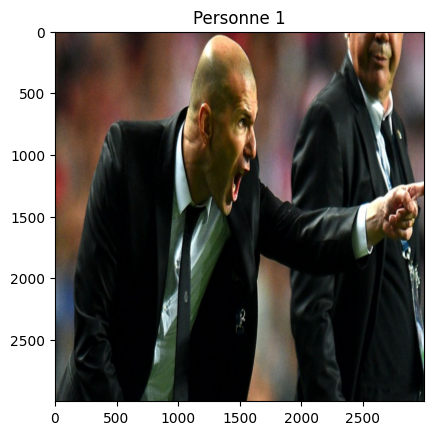

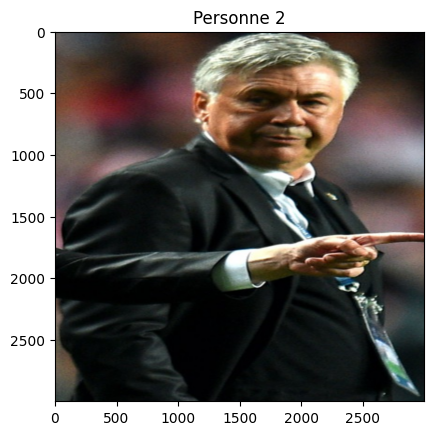

Nombre de personnes : 2


In [4]:

from ultralytics import YOLO
import cv2
from ultralytics.utils.plotting import Annotator
import matplotlib.pyplot as plt

# Charger le modèle YOLOv8
model = YOLO('yolov8n.pt')

# Charger l'image
img = cv2.imread('68747470733a2f2f756c7472616c79746963732e636f6d2f696d616765732f7a6964616e652e6a7067.jpeg')

# Redimensionner l'image à 720x1340

# Prédire les objets dans l'image
results = model.predict(img)

# Compter le nombre de personnes
num_people = 0

# Parcourir chaque résultat
for r in results:
    boxes = r.boxes
    for box in boxes:
        # Vérifier si la classe de l'objet est une personne
        if model.names[int(box.cls)] == 'person':
            num_people += 1
            # Dessiner la boîte englobante
            b = box.xyxy[0]  # obtenir les coordonnées de la boîte au format (haut, gauche, bas, droite)
            
            # Cropper l'image pour obtenir seulement la boîte englobante
            cropped_img = img[int(b[1]):int(b[3]), int(b[0]):int(b[2])]
            cropped_img2 = cv2.resize(cropped_img, (3000, 3000))

            # Afficher l'image croppée
            plt.figure()
            plt.imshow(cv2.cvtColor(cropped_img2, cv2.COLOR_BGR2RGB))
            plt.title(f'Personne {num_people}')
            plt.show()

# Afficher le nombre de personnes
print(f'Nombre de personnes : {num_people}')


In [9]:
!pip install keras-tuner


   ---------------------------------------- 0.0/128.9 kB ? eta -:--:--
   ---------------------------------------- 0.0/128.9 kB ? eta -:--:--
   ---------------------------------------- 0.0/128.9 kB ? eta -:--:--
   --- ------------------------------------ 10.2/128.9 kB ? eta -:--:--
   --- ------------------------------------ 10.2/128.9 kB ? eta -:--:--
   --- ------------------------------------ 10.2/128.9 kB ? eta -:--:--
   --- ------------------------------------ 10.2/128.9 kB ? eta -:--:--
   --------- ----------------------------- 30.7/128.9 kB 119.1 kB/s eta 0:00:01
   --------- ----------------------------- 30.7/128.9 kB 119.1 kB/s eta 0:00:01
   --------- ----------------------------- 30.7/128.9 kB 119.1 kB/s eta 0:00:01
   --------- ----------------------------- 30.7/128.9 kB 119.1 kB/s eta 0:00:01
   --------- ----------------------------- 30.7/128.9 kB 119.1 kB/s eta 0:00:01
   --------- ----------------------------- 30.7/128.9 kB 119.1 kB/s eta 0:00:01
   --------- ------

In [2]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization

def build_model(dense_units=128, dropout_rate=0.0, learning_rate=1e-3):
    model = Sequential()
    model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(640, 640, 3)))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Flatten())
    model.add(Dense(units=dense_units, activation='relu'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate),
                  loss='binary_crossentropy',
                  metrics=['accuracy'])
    return model

model = build_model()
model.summary()


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 638, 638, 32)      896       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 319, 319, 32)     0         
 2D)                                                             
                                                                 
 batch_normalization_3 (Batc  (None, 319, 319, 32)     128       
 hNormalization)                                                 
                                                                 
 conv2d_4 (Conv2D)           (None, 317, 317, 64)      18496     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 158, 158, 64)     0         
 2D)                                                             
                                                      

Found 11527 validated image filenames belonging to 3 classes.
Found 2530 validated image filenames belonging to 3 classes.
Epoch 1/25
769/769 [==============================] - 137s 174ms/step - loss: 2.3861 - accuracy: 0.4702 - val_loss: 2.3466 - val_accuracy: 0.3735
Epoch 2/25
769/769 [==============================] - 133s 173ms/step - loss: 0.6690 - accuracy: 0.6447 - val_loss: 3.5566 - val_accuracy: 0.3083
Epoch 3/25
769/769 [==============================] - 140s 181ms/step - loss: 0.5547 - accuracy: 0.6654 - val_loss: 3.3373 - val_accuracy: 0.3150
Epoch 4/25
769/769 [==============================] - 144s 187ms/step - loss: 0.5294 - accuracy: 0.6650 - val_loss: 4.2267 - val_accuracy: 0.3356


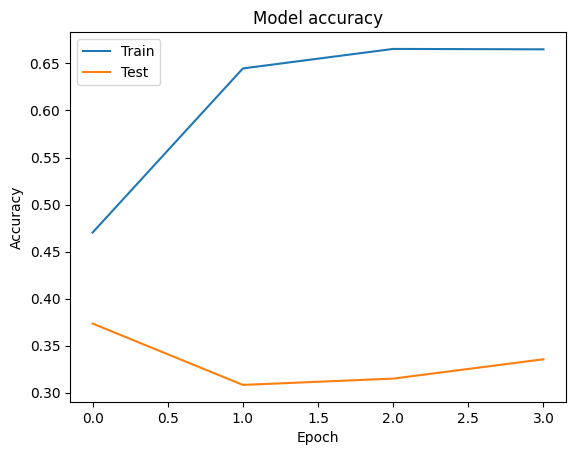

C:\Users\omarm\AppData\Local\Temp\ipykernel_12376\3893151708.py:69: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  Y_pred = model.predict_generator(val_data, val_data.samples // 32+1)


Confusion Matrix


ValueError: Found input variables with inconsistent numbers of samples: [2530, 1200]

In [2]:
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np

# Read the Excel file
df = pd.read_csv(r'C:\Users\omarm\Downloads\train\driver_imgs_list.csv')

# Filter the dataframe to only include the classes you're interested in
df = df[df['classname'].isin(['c0', 'c2', 'c4', 'c1', 'c3','c5'])]

# Map the classnames to your labels
# Map the classnames to your labels and convert to string
label_map = {'c0': '0', 'c2': '2', 'c4': '2', 'c1': '1', 'c3': '1', 'c5': '0'}
df['label'] = df['classname'].map(label_map)

def build_model():
    model = Sequential()
    model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(640, 480, 3)))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(BatchNormalization())
    model.add(Flatten())
    model.add(Dense(units=128, activation='relu'))
    model.add(Dense(3, activation='softmax')) 
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])
    return model

# Create a data generator
datagen = ImageDataGenerator(validation_split=0.18) 

# Load the training data
train_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=25, subset='training')

# Load the validation data
val_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=25, subset='validation')

model = build_model()


history = model.fit(train_data,
             epochs=25,
             validation_data=val_data,
             )

# Plot accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()




In [3]:
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np

# Read the Excel file
df = pd.read_csv(r'C:\Users\omarm\Downloads\train\driver_imgs_list.csv')

# Filter the dataframe to only include the classes you're interested in
df = df[df['classname'].isin(['c0', 'c2', 'c4', 'c1', 'c3','c5'])]

# Map the classnames to your labels
# Map the classnames to your labels and convert to string
label_map = {'c0': '0', 'c2': '2', 'c4': '2', 'c1': '1', 'c3': '1', 'c5': '0'}
df['label'] = df['classname'].map(label_map)

def build_model():
    model = Sequential()
    model.add(Conv2D(16, (3, 3), activation='relu', input_shape=(640, 480, 3)))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(32, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))    
    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Flatten())
    model.add(Dense(units=128, activation='relu'))
    model.add(Dense(3, activation='softmax')) 
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])
    return model

# Create a data generator
datagen = ImageDataGenerator(validation_split=0.18) 

# Load the training data
train_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=25, subset='training')

# Load the validation data
val_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=25, subset='validation')

model = build_model()


history = model.fit(train_data,
             epochs=25,
             validation_data=val_data,
             )

# Plot accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()
model.save('classification_a_3.h5')



Found 11527 validated image filenames belonging to 3 classes.
Found 2530 validated image filenames belonging to 3 classes.
Epoch 1/25
462/462 [==============================] - 77s 161ms/step - loss: 8.2226 - accuracy: 0.8971 - val_loss: 2.2340 - val_accuracy: 0.4344
Epoch 2/25
462/462 [==============================] - 74s 160ms/step - loss: 0.0295 - accuracy: 0.9905 - val_loss: 2.7851 - val_accuracy: 0.4099
Epoch 3/25
462/462 [==============================] - 74s 160ms/step - loss: 0.0160 - accuracy: 0.9943 - val_loss: 2.8401 - val_accuracy: 0.4194
Epoch 4/25
462/462 [==============================] - 76s 164ms/step - loss: 0.0292 - accuracy: 0.9925 - val_loss: 2.3032 - val_accuracy: 0.4174
Epoch 5/25
462/462 [==============================] - 76s 163ms/step - loss: 0.0166 - accuracy: 0.9950 - val_loss: 2.2812 - val_accuracy: 0.4854
Epoch 6/25
462/462 [==============================] - 77s 166ms/step - loss: 0.0149 - accuracy: 0.9958 - val_loss: 4.9864 - val_accuracy: 0.4312
Epoch 7

KeyboardInterrupt: 

In [1]:
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras import regularizers
# Read the Excel file
df = pd.read_csv(r'C:\Users\omarm\Downloads\train\driver_imgs_list.csv')

# Filter the dataframe to only include the classes you're interested in
df = df[df['classname'].isin(['c0', 'c2', 'c4', 'c1', 'c3','c5'])]

# Map the classnames to your labels
# Map the classnames to your labels and convert to string
label_map = {'c0': '0', 'c2': '2', 'c4': '2', 'c1': '1', 'c3': '1', 'c5': '0'}
df['label'] = df['classname'].map(label_map)

def build_model():
    model = Sequential()
    model.add(Conv2D(32, (3, 3), activation='relu', kernel_regularizer=regularizers.l2(0.01), input_shape=(640, 480, 3)))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(64, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(128, (3, 3), activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))    
    
    model.add(Flatten())
    model.add(Dense(units=64, activation='relu'))
    model.add(Dense(3, activation='softmax')) 
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])
    return model

# Create a data generator
datagen = ImageDataGenerator(validation_split=0.25) 

# Load the training data
train_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=26, subset='training')

# Load the validation data
val_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=26, subset='validation')

model = build_model()


history = model.fit(train_data,
             epochs=15,
             validation_data=val_data,
             )

# Plot accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()
model.save('classification_a_3.h5')


Found 10543 validated image filenames belonging to 3 classes.
Found 3514 validated image filenames belonging to 3 classes.
Epoch 1/15
406/406 [==============================] - 127s 281ms/step - loss: 36.1289 - accuracy: 0.8821 - val_loss: 13.5362 - val_accuracy: 0.3219
Epoch 2/15
406/406 [==============================] - 111s 273ms/step - loss: 0.1021 - accuracy: 0.9852 - val_loss: 5.4980 - val_accuracy: 0.3241
Epoch 3/15
406/406 [==============================] - 115s 282ms/step - loss: 0.0981 - accuracy: 0.9861 - val_loss: 9.1347 - val_accuracy: 0.3019
Epoch 4/15
406/406 [==============================] - 118s 290ms/step - loss: 0.0834 - accuracy: 0.9890 - val_loss: 11.7613 - val_accuracy: 0.3116
Epoch 5/15
 43/406 [==>...........................] - ETA: 1:23 - loss: 0.0914 - accuracy: 0.9848

KeyboardInterrupt: 

In [5]:
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras import regularizers
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))


# Read the Excel file
df = pd.read_csv(r'C:\Users\omarm\Downloads\train\driver_imgs_list.csv')

# Filter the dataframe to only include the classes you're interested in
df = df[df['classname'].isin(['c0', 'c2', 'c4', 'c1', 'c3','c5'])]

# Map the classnames to your labels
# Map the classnames to your labels and convert to string
label_map = {'c0': '0', 'c2': '2', 'c4': '2', 'c1': '1', 'c3': '1', 'c5': '0'}
df['label'] = df['classname'].map(label_map)

def build_model():
    model = Sequential()
    model.add(Conv2D(8, (3, 3),1, activation='relu', input_shape=(640, 480, 3)))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(16, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(32, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(64, (5, 5), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(128, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Flatten())
    model.add(Dense(units=128, activation='relu'))
    model.add(Dense(3, activation='softmax')) 
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])
    return model

# Create a data generator
datagen = ImageDataGenerator(
      # normalize pixel values
    validation_split=0.25  # set validation split
      # add padding
)

# Load the training data
train_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=18, subset='training')

# Load the validation data
val_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=18, subset='validation')

model = build_model()
# Using data normalization



history = model.fit(train_data,
             epochs=15,
             validation_data=val_data,
             )

# Plot accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()
model.save('classification_a_3.h5')


Num GPUs Available:  1
Found 10543 validated image filenames belonging to 3 classes.
Found 3514 validated image filenames belonging to 3 classes.
Epoch 1/15
879/879 [==============================] - 83s 93ms/step - loss: 0.4033 - accuracy: 0.9066 - val_loss: 2.3038 - val_accuracy: 0.5100
Epoch 2/15
879/879 [==============================] - 76s 87ms/step - loss: 0.0433 - accuracy: 0.9846 - val_loss: 3.2194 - val_accuracy: 0.5000
Epoch 3/15
879/879 [==============================] - 78s 89ms/step - loss: 0.0375 - accuracy: 0.9888 - val_loss: 3.2405 - val_accuracy: 0.5922
Epoch 4/15
879/879 [==============================] - 84s 95ms/step - loss: 0.0302 - accuracy: 0.9926 - val_loss: 2.1163 - val_accuracy: 0.5578
Epoch 5/15
879/879 [==============================] - 82s 93ms/step - loss: 0.0152 - accuracy: 0.9954 - val_loss: 3.0595 - val_accuracy: 0.5706
Epoch 6/15
879/879 [==============================] - 87s 99ms/step - loss: 0.0313 - accuracy: 0.9919 - val_loss: 4.5188 - val_accurac

KeyboardInterrupt: 

In [ ]:
import pandas as pd
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras import regularizers
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))


# Read the Excel file
df = pd.read_csv(r'C:\Users\omarm\Downloads\train\driver_imgs_list.csv')

# Filter the dataframe to only include the classes you're interested in
df = df[df['classname'].isin(['c0', 'c2', 'c4', 'c1', 'c3','c5'])]

# Map the classnames to your labels
# Map the classnames to your labels and convert to string
label_map = {'c0': '0', 'c2': '2', 'c4': '2', 'c1': '1', 'c3': '1', 'c5': '0'}
df['label'] = df['classname'].map(label_map)

def build_model():
    model = Sequential()
    model.add(Conv2D(4, (3, 3),1, activation='relu', input_shape=(640, 480, 3)))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(8, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(16, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(32, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(64, (5, 5), 1,padding='same',activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(64, (7, 7), 1,padding='same',activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(128, (7, 7), 1,padding='same',activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(258, (7, 7), 1,padding='same',activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Flatten())
    model.add(Dense(units=258, activation='relu'))
    model.add(Dense(3, activation='softmax')) 
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])
    return model

# Create a data generator
datagen = ImageDataGenerator(
      # normalize pixel values
    
    validation_split=0.50  # set validation split
      # add padding
)

# Load the training data
train_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=12, subset='training')

# Load the validation data
val_data = datagen.flow_from_dataframe(df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=12, subset='validation')

model = build_model()
# Using data normalization



history = model.fit(train_data,
             epochs=15,
             validation_data=val_data,
             )

# Plot accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()
model.save('classification_a_3.h5')


In [2]:
import pandas as pd
from tensorflow.keras.callbacks import ModelCheckpoint

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras import regularizers
from sklearn.model_selection import train_test_split

print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

# Read the Excel file
df = pd.read_csv(r'C:\Users\omarm\Downloads\train\driver_imgs_list.csv')

# Filter the dataframe to only include the classes you're interested in
df = df[df['classname'].isin(['c0', 'c2', 'c4', 'c1', 'c3','c5','c6', 'c7', 'c8', 'c9'])]

# Map the classnames to your labels and convert to string
label_map = {'c0': '0', 'c2': '1', 'c4': '1', 'c1': '0', 'c3': '0', 'c5': '0', 'c6': '0', 'c7': '0', 'c8': '0','c9': '0'}
df['label'] = df['classname'].map(label_map).astype('str')

# Split the data into a training set and a test set
train_df, test_df = train_test_split(df, test_size=0.1, stratify=df['label'], random_state=42)


# For the test set, you can create a new ImageDataGenerator without the validation_split
test_datagen = ImageDataGenerator()
test_data = test_datagen.flow_from_dataframe(test_df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=50, class_mode='binary')

# Load the saved model
from tensorflow.keras.models import load_model
# Load the best model
best_model = load_model('best_model.h5')

# Evaluate the best model on the test set
test_loss, test_accuracy = best_model.evaluate(test_data)

print(f'Test accuracy: {test_accuracy}')


Num GPUs Available:  1
Found 2243 validated image filenames belonging to 2 classes.


ValueError: The channel dimension of the inputs should be defined. The input_shape received is (None, None, None, None), where axis -1 (0-based) is the channel dimension, which found to be `None`.

Num GPUs Available:  1
Found 9840 validated image filenames belonging to 5 classes.
Found 2811 validated image filenames belonging to 5 classes.
Epoch 1/16
197/197 [==============================] - ETA: 0s - loss: 3.7205 - accuracy: 0.8083
Epoch 1: val_accuracy improved from -inf to 0.97794, saving model to best_model(1).h5
197/197 [==============================] - 129s 601ms/step - loss: 3.7205 - accuracy: 0.8083 - val_loss: 0.0853 - val_accuracy: 0.9779
Epoch 2/16
197/197 [==============================] - ETA: 0s - loss: 0.0331 - accuracy: 0.9904
Epoch 2: val_accuracy improved from 0.97794 to 0.98470, saving model to best_model(1).h5
197/197 [==============================] - 66s 333ms/step - loss: 0.0331 - accuracy: 0.9904 - val_loss: 0.0518 - val_accuracy: 0.9847
Epoch 3/16
197/197 [==============================] - ETA: 0s - loss: 0.0185 - accuracy: 0.9952
Epoch 3: val_accuracy improved from 0.98470 to 0.99039, saving model to best_model(1).h5
197/197 [=========================

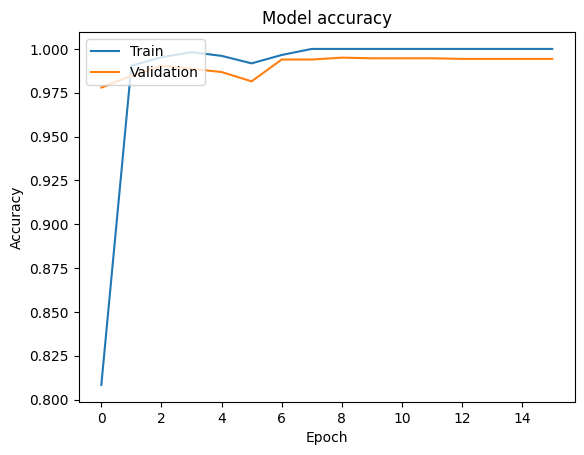

Found 1406 validated image filenames belonging to 5 classes.
24/24 [==============================] - 13s 503ms/step - loss: 0.0190 - accuracy: 0.9964
Test accuracy: 0.9964438080787659


In [1]:
import pandas as pd
from tensorflow.keras.callbacks import ModelCheckpoint

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras import regularizers
from sklearn.model_selection import train_test_split

print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

# Read the Excel file
df = pd.read_csv(r'C:\Users\omarm\Downloads\train\driver_imgs_list.csv')

df = df[df['classname'].isin(['c0', 'c2', 'c4', 'c1', 'c3','c5'])]

# Map the classnames to your labels and convert to string
label_map = {'c0': '0', 'c2': '2', 'c4': '4', 'c1': '1', 'c3': '3', 'c5': '0' }
df['label'] = df['classname'].map(label_map).astype('str')

# Split the data into a training set and a test set
train_df, test_df = train_test_split(df, test_size=0.1, stratify=df['label'], random_state=42)
def build_model():
    model = Sequential()
    
    model.add(Conv2D(8, (3, 3),1, activation='relu',input_shape=(640, 480, 3)))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    
    
    
    model.add(Conv2D(16, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    
    model.add(Conv2D(32, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    
    model.add(Conv2D(64, (5, 5), 1,padding='same',activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    
    
    
    model.add(Flatten())
    model.add(Dense(units=64, activation='relu'))
    model.add(Dense(5, activation='softmax')) 
    
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='categorical_crossentropy', 
                  metrics=['accuracy'])
    return model

# Create a data generator
datagen = ImageDataGenerator(
    validation_split=0.2222  # set validation split to get 70% training, 20% validation
)

# Load the training data
train_data = datagen.flow_from_dataframe(train_df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=50, subset='training', class_mode='categorical')

# Load the validation data
val_data = datagen.flow_from_dataframe(train_df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=50, subset='validation', class_mode='categorical')

checkpoint = ModelCheckpoint('best_model(1).h5', monitor='val_accuracy', mode='max', verbose=1, save_best_only=True)

model = build_model()

history = model.fit(train_data,
             epochs=16,
             validation_data=val_data,
             callbacks=[checkpoint]  # Pass the checkpoint to the fit function
             )

# Plot accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

# Save the model


# For the test set, you can create a new ImageDataGenerator without the validation_split
test_datagen = ImageDataGenerator()
test_data = test_datagen.flow_from_dataframe(test_df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=60, class_mode='categorical')

# Load the saved model
from tensorflow.keras.models import load_model
# Load the best model
best_model = load_model('best_model(1).h5')

# Evaluate the best model on the test set
test_loss, test_accuracy = best_model.evaluate(test_data)

print(f'Test accuracy: {test_accuracy}')


In [4]:

test_datagen = ImageDataGenerator()
test_data = test_datagen.flow_from_dataframe(test_df, directory=r'C:\Users\omarm\Downloads\train\allphotos', x_col='img', y_col='label', target_size=(640, 480), batch_size=60, class_mode='categorical')

# Load the saved model
from tensorflow.keras.models import load_model
# Load the best model
best_model = load_model('best_model.h5')

# Evaluate the best model on the test set
test_loss, test_accuracy = best_model.evaluate(test_data)

print(f'Test accuracy: {test_accuracy}')
print(f'test_loss: {test_loss}')

NameError: name 'test_df' is not defined

In [7]:
import pandas as pd
from tensorflow.keras.callbacks import ModelCheckpoint

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras import regularizers
from sklearn.model_selection import train_test_split

from tensorflow.keras.preprocessing.image import ImageDataGenerator
import pandas as pd
from tensorflow.keras.models import load_model

# Create an ImageDataGenerator object
datagen = ImageDataGenerator()

# Create a dataframe containing the image file name
df = pd.DataFrame({'filename': [r"C:\Users\omarm\Downloads\thibault-penin-a8r2KKLSntA-unsplash.jpg"]})

# Use flow_from_dataframe to load and preprocess the image
img_gen = datagen.flow_from_dataframe(df, 
                                      directory='.', 
                                      x_col='filename', 
                                      class_mode=None, 
                                      target_size=(640, 480), 
                                      batch_size=1, 
                                      shuffle=False)
best_model = load_model('best_model.h5')

# Make a prediction
predictions = best_model.predict(img_gen)

# Get the class with the highest probability ta7founYaser
predicted_class = np.argmax(predictions[0])

print(f'Predicted class: {predicted_class}')


Found 1 validated image filenames.
1/1 [==============================] - 0s 212ms/step
Predicted class: 0


1/1 [==============================] - 0s 131ms/step
The person is talking on the phone.
Predicted probability: 0.99139494


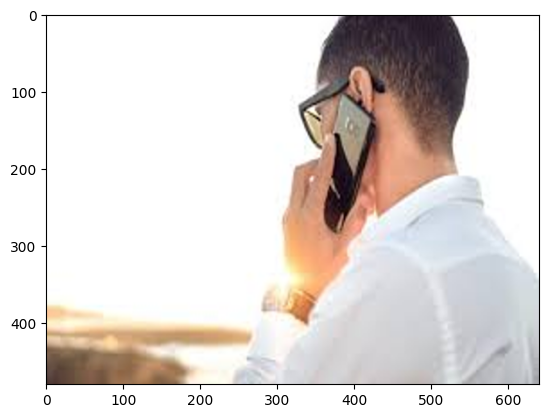

Found 1 validated image filenames.
1/1 [==============================] - 0s 389ms/step


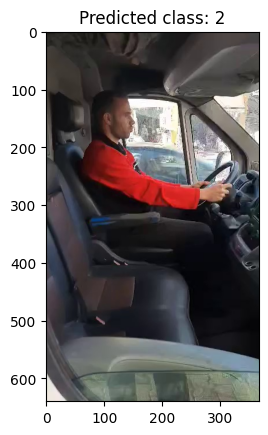

Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


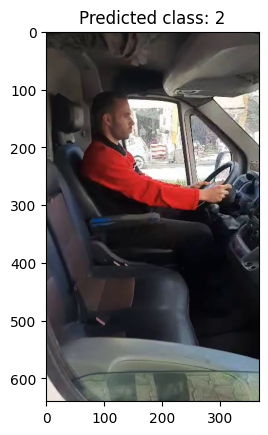

Found 1 validated image filenames.
1/1 [==============================] - 0s 46ms/step


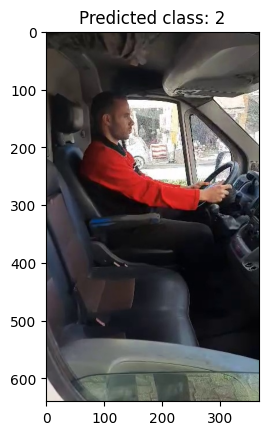

Found 1 validated image filenames.
1/1 [==============================] - 0s 53ms/step


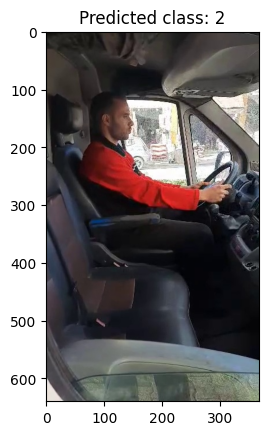

Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


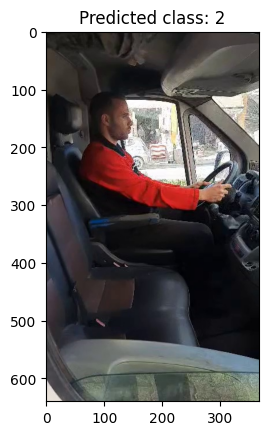

Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


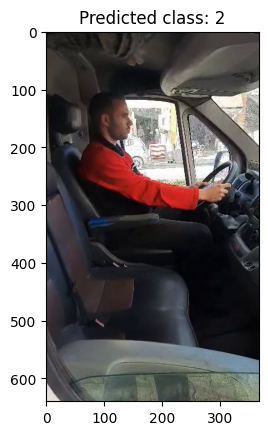

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


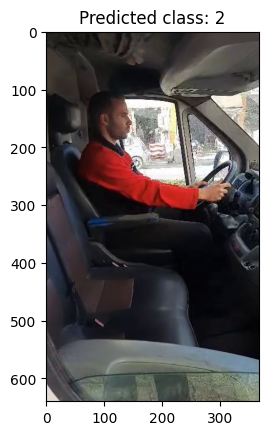

Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


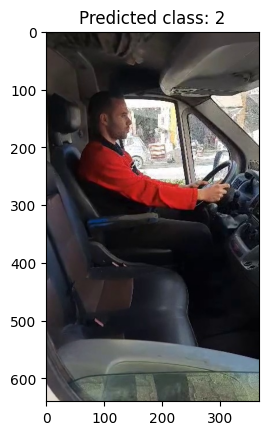

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


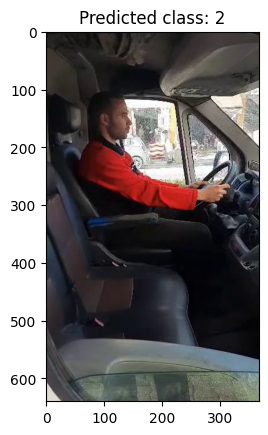

Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


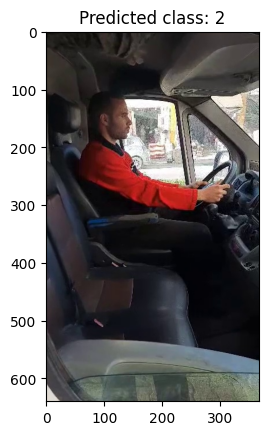

Found 1 validated image filenames.
1/1 [==============================] - 0s 47ms/step


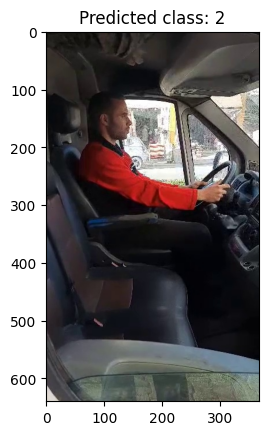

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


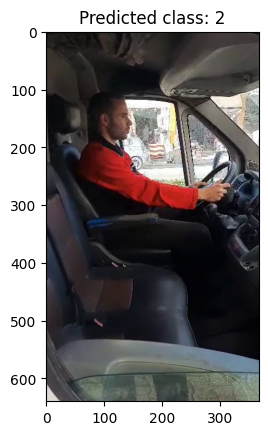

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


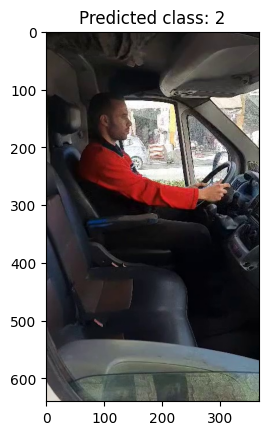

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


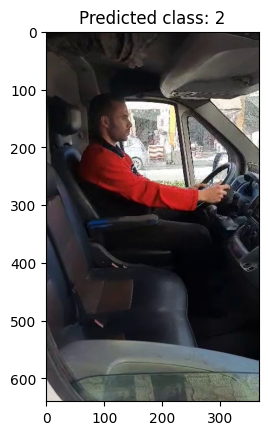

Found 1 validated image filenames.
1/1 [==============================] - 0s 37ms/step


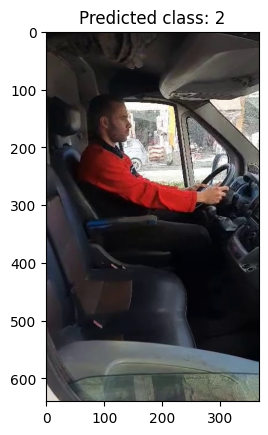

Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


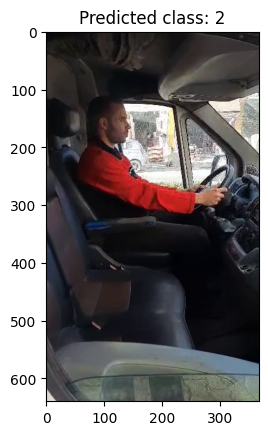

Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


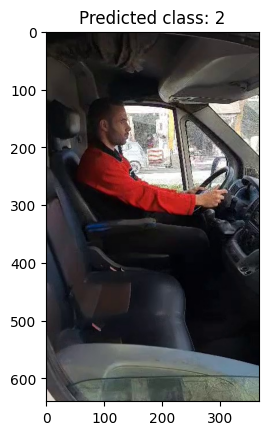

Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


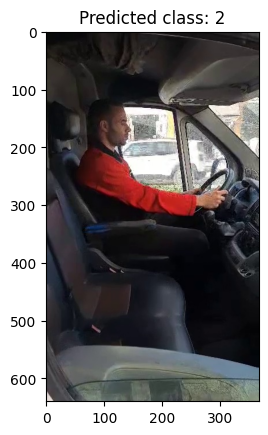

Found 1 validated image filenames.
1/1 [==============================] - 0s 33ms/step


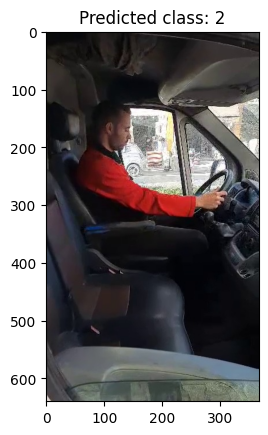

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


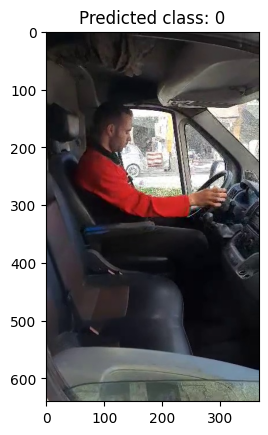

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


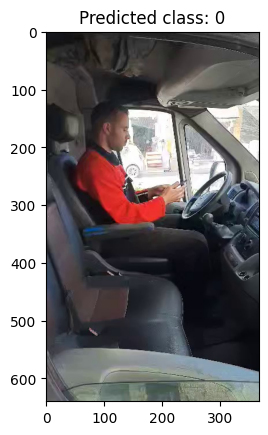

Found 1 validated image filenames.
1/1 [==============================] - 0s 33ms/step


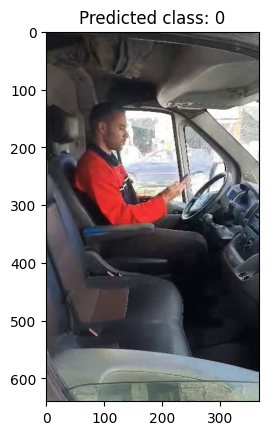

Found 1 validated image filenames.
1/1 [==============================] - 0s 37ms/step


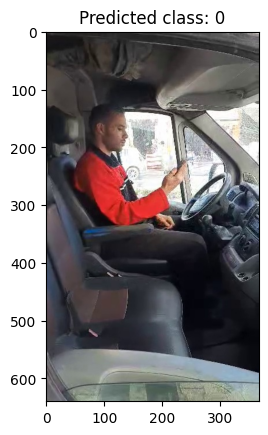

Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


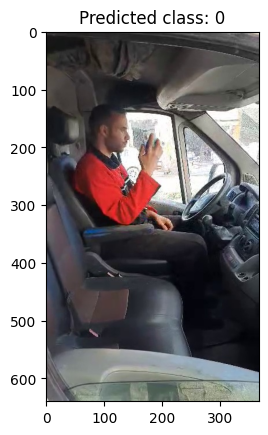

Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


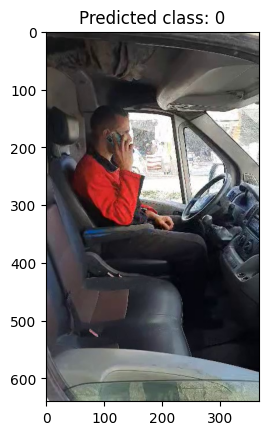

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


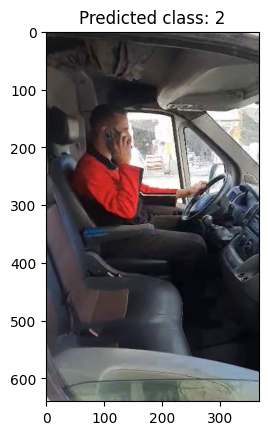

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


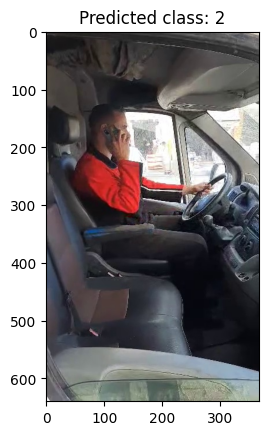

Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


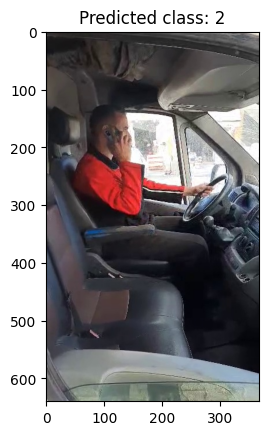

Found 1 validated image filenames.
1/1 [==============================] - 0s 43ms/step


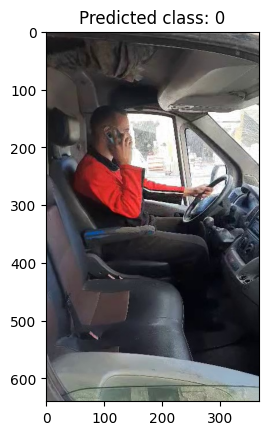

Found 1 validated image filenames.
1/1 [==============================] - 0s 47ms/step


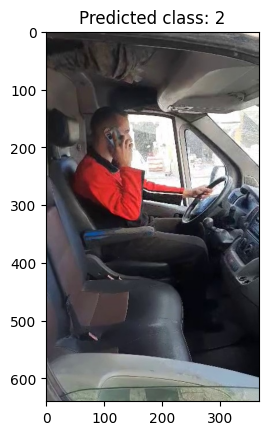

Found 1 validated image filenames.
1/1 [==============================] - 0s 69ms/step


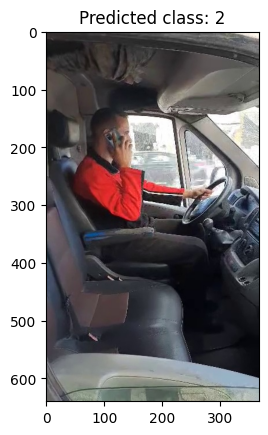

Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


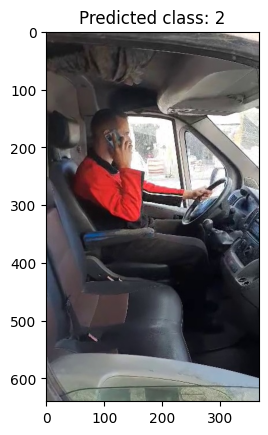

Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


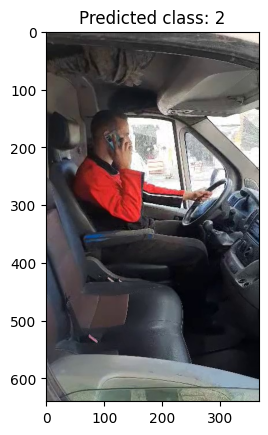

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


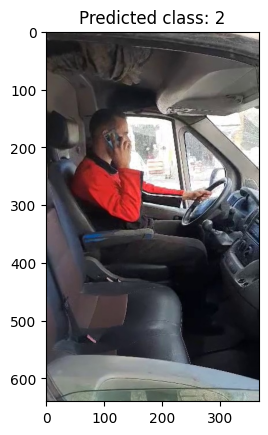

Found 1 validated image filenames.
1/1 [==============================] - 0s 51ms/step


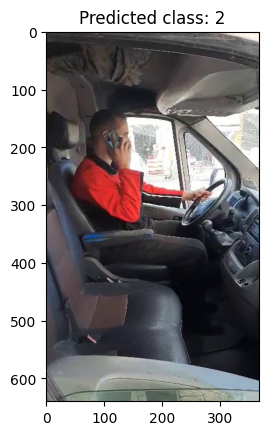

Found 1 validated image filenames.
1/1 [==============================] - 0s 37ms/step


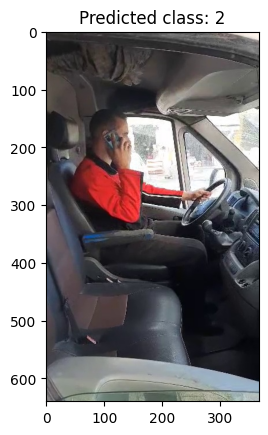

Found 1 validated image filenames.
1/1 [==============================] - 0s 62ms/step


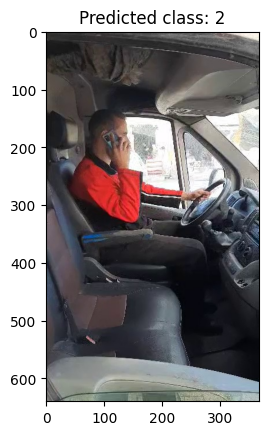

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


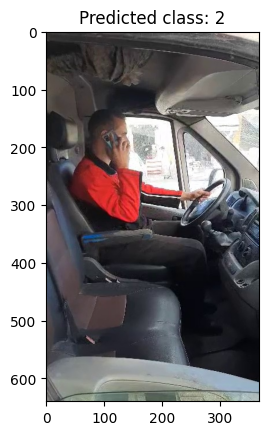

Found 1 validated image filenames.
1/1 [==============================] - 0s 45ms/step


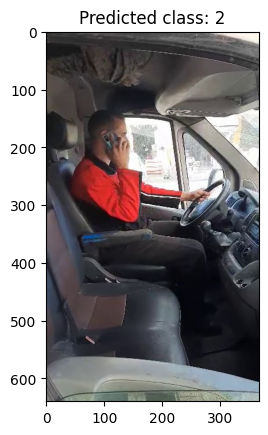

Found 1 validated image filenames.
1/1 [==============================] - 0s 37ms/step


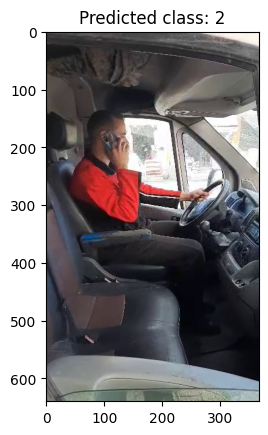

Found 1 validated image filenames.
1/1 [==============================] - 0s 38ms/step


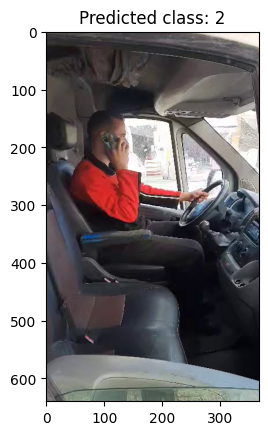

Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


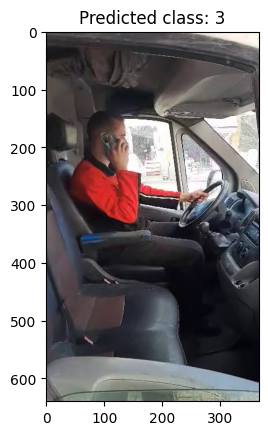

Found 1 validated image filenames.
1/1 [==============================] - 0s 38ms/step


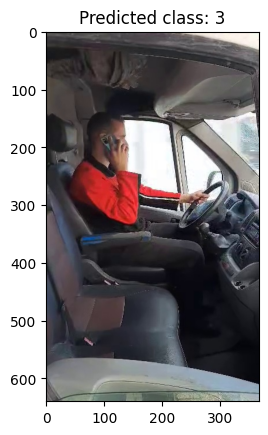

Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


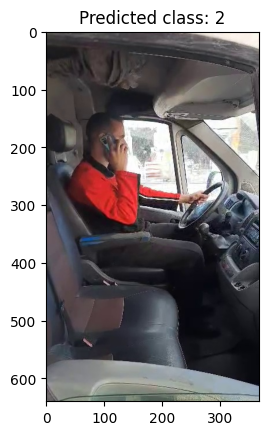

Found 1 validated image filenames.
1/1 [==============================] - 0s 37ms/step


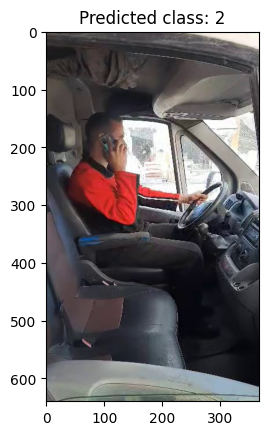

Found 1 validated image filenames.
1/1 [==============================] - 0s 43ms/step


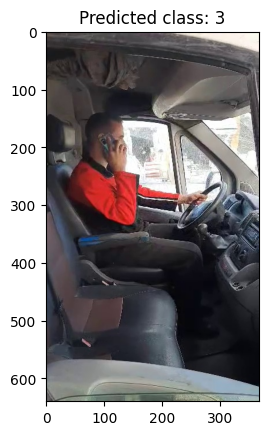

Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


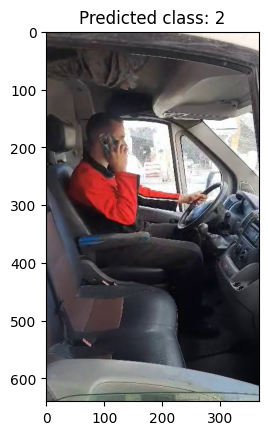

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


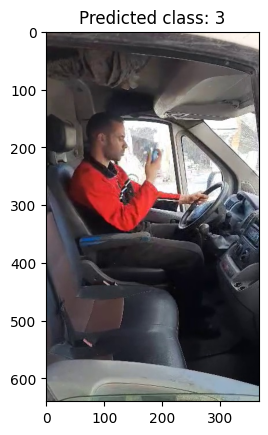

Found 1 validated image filenames.
1/1 [==============================] - 0s 48ms/step


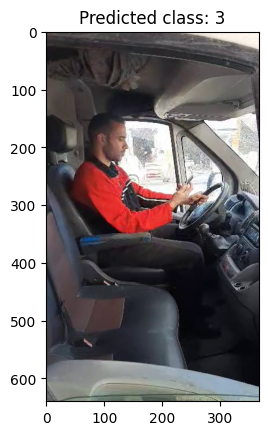

Found 1 validated image filenames.
1/1 [==============================] - 0s 46ms/step


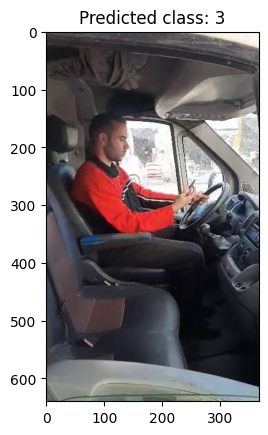

Found 1 validated image filenames.
1/1 [==============================] - 0s 43ms/step


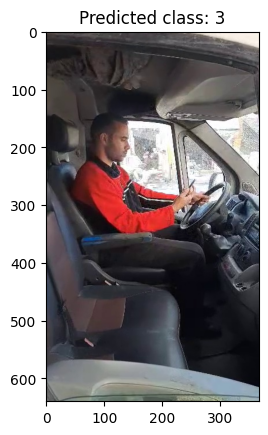

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


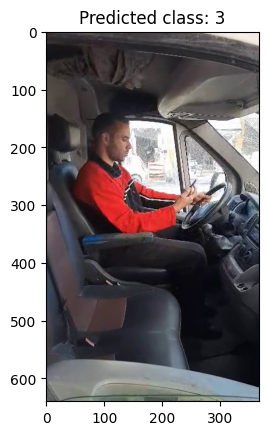

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


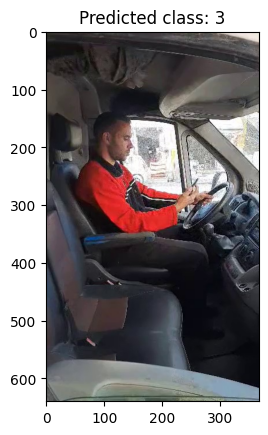

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


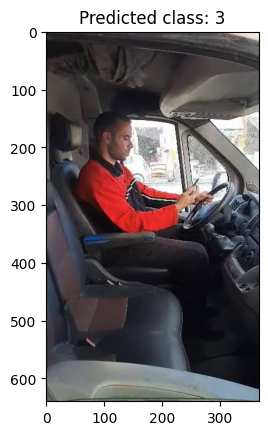

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


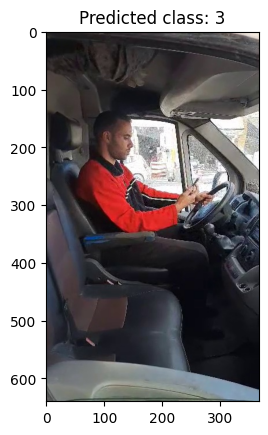

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


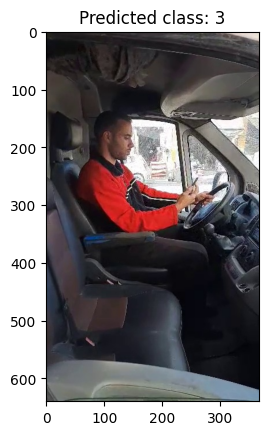

Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


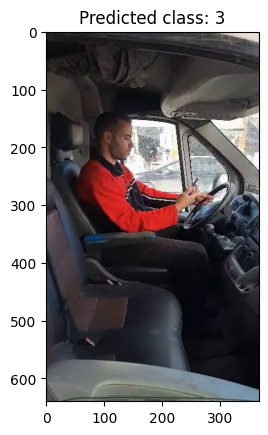

Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


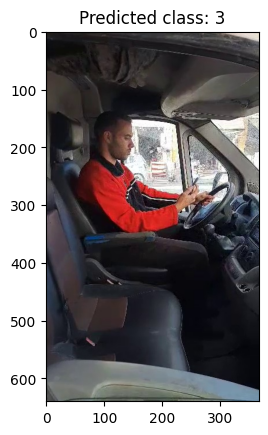

Found 1 validated image filenames.
1/1 [==============================] - 0s 37ms/step


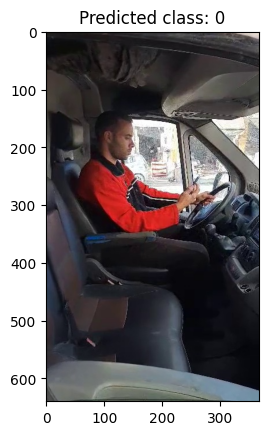

Found 1 validated image filenames.
1/1 [==============================] - 0s 43ms/step


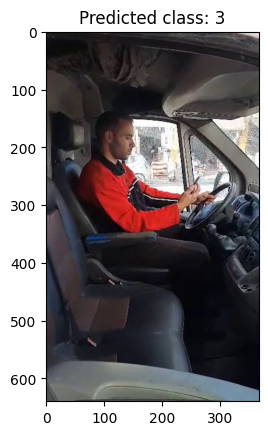

Found 1 validated image filenames.
1/1 [==============================] - 0s 33ms/step


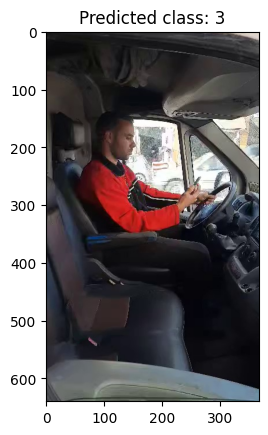

Found 1 validated image filenames.
1/1 [==============================] - 0s 33ms/step


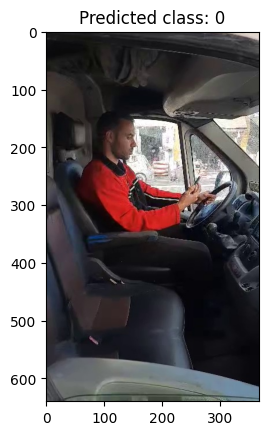

Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


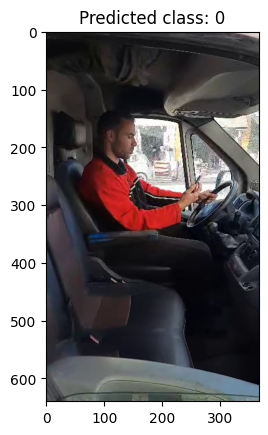

Found 1 validated image filenames.
1/1 [==============================] - 0s 38ms/step


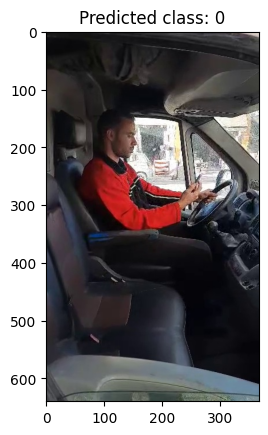

Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


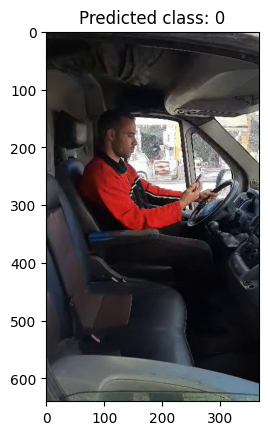

Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


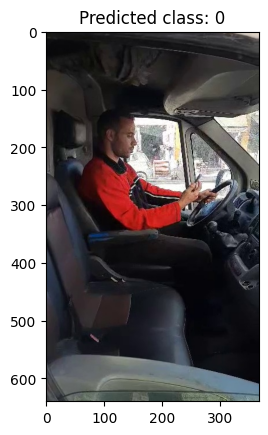

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


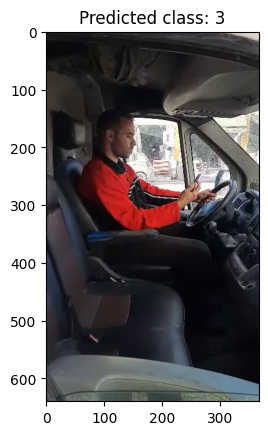

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


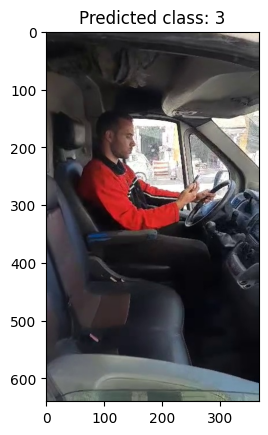

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


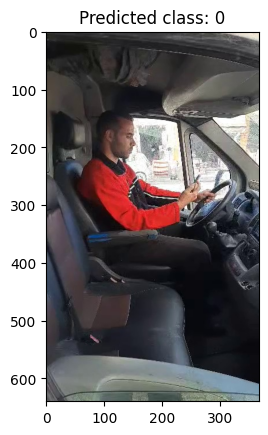

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


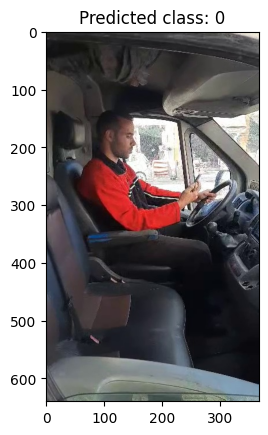

Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


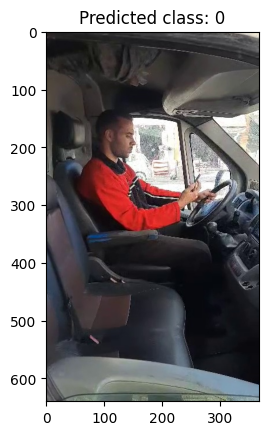

Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


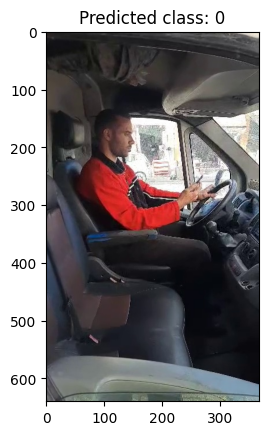

Found 1 validated image filenames.
1/1 [==============================] - 0s 38ms/step


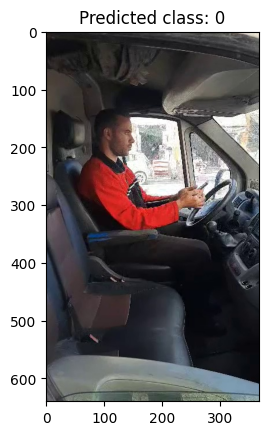

Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


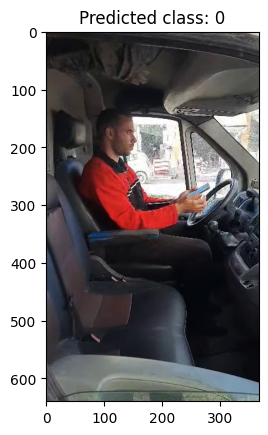

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


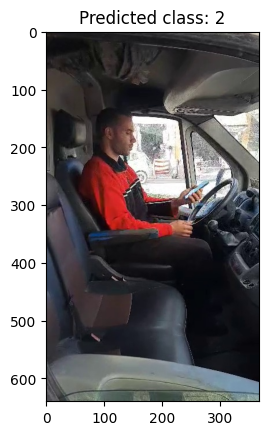

Found 1 validated image filenames.
1/1 [==============================] - 0s 33ms/step


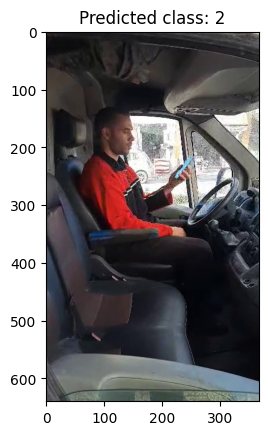

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


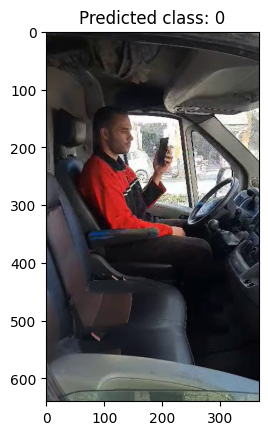

Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


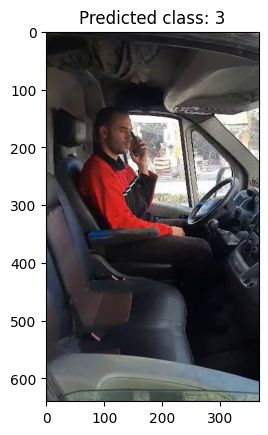

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


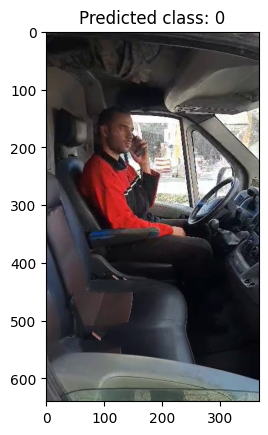

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


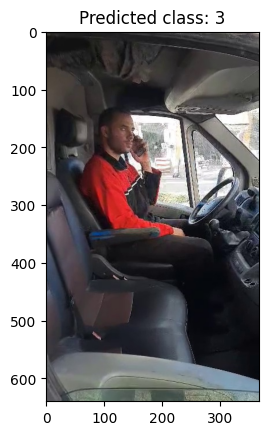

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


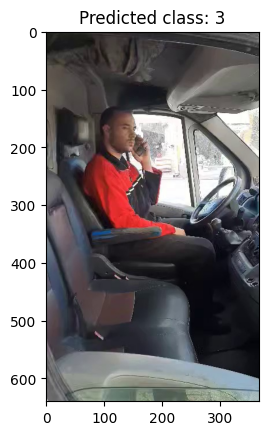

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


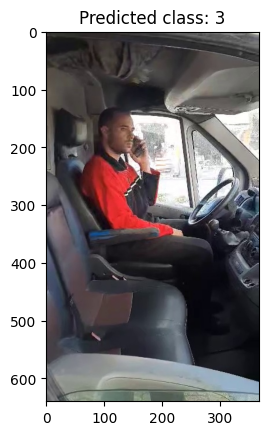

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


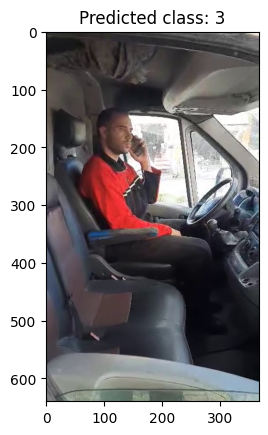

Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


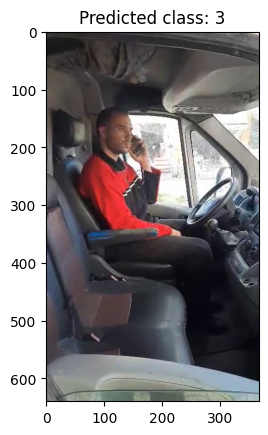

Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


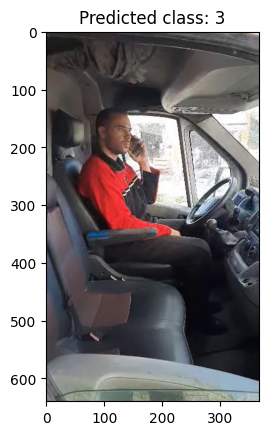

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


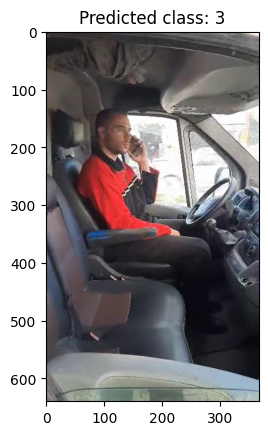

Found 1 validated image filenames.
1/1 [==============================] - 0s 38ms/step


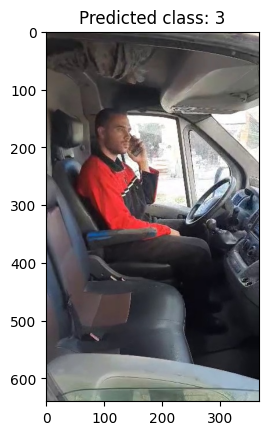

Found 1 validated image filenames.
1/1 [==============================] - 0s 37ms/step


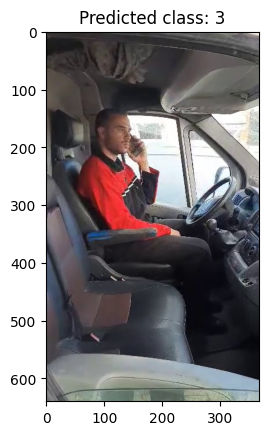

Found 1 validated image filenames.
1/1 [==============================] - 0s 38ms/step


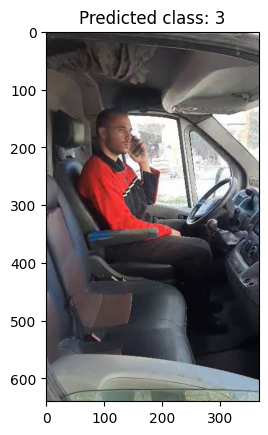

Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


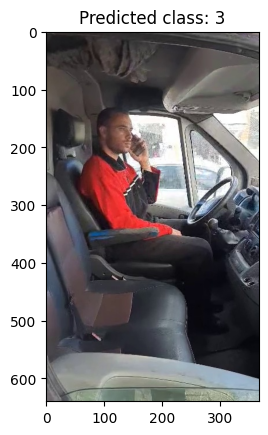

Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


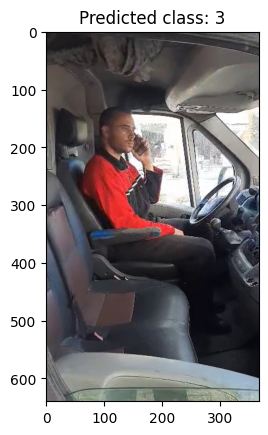

Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


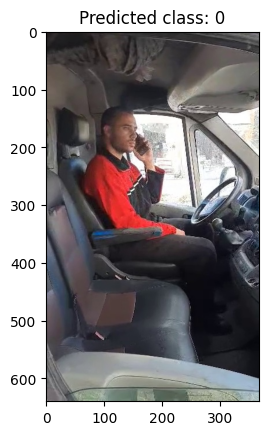

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


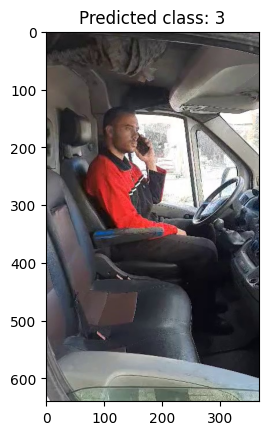

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


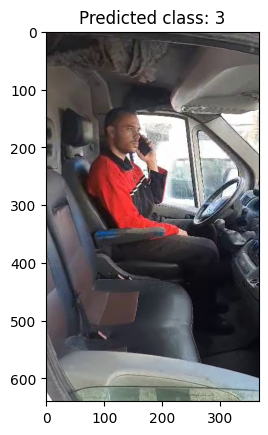

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


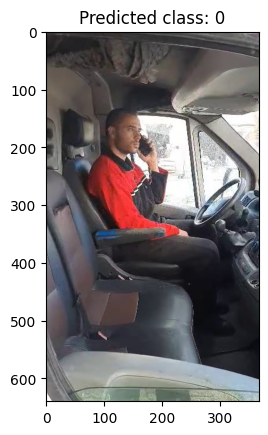

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


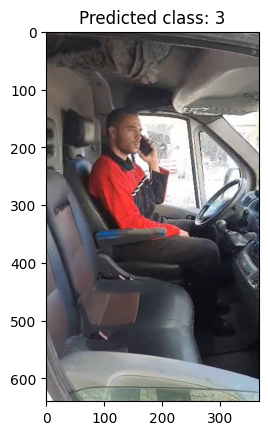

Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


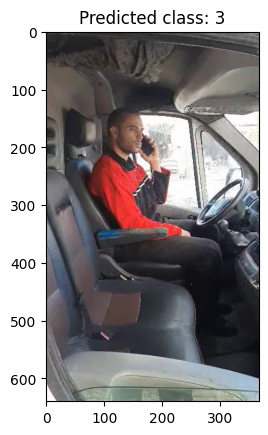

Found 1 validated image filenames.
1/1 [==============================] - 0s 37ms/step


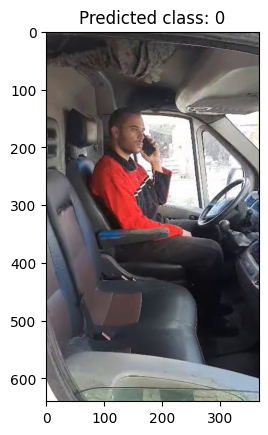

Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


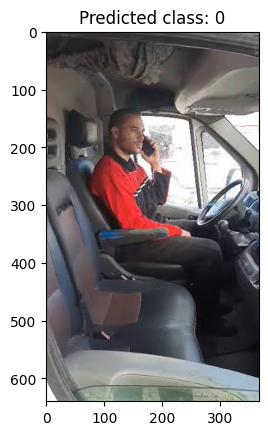

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


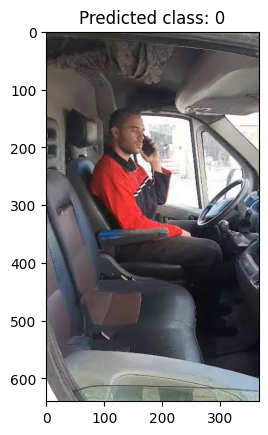

Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


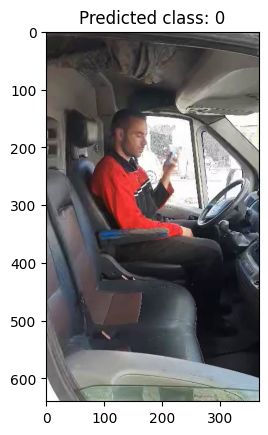

Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


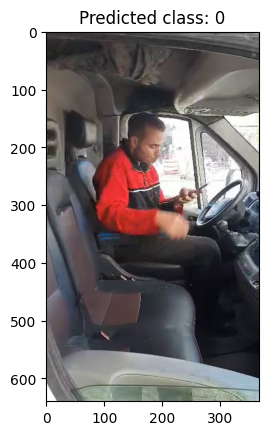

Found 1 validated image filenames.
1/1 [==============================] - 0s 34ms/step


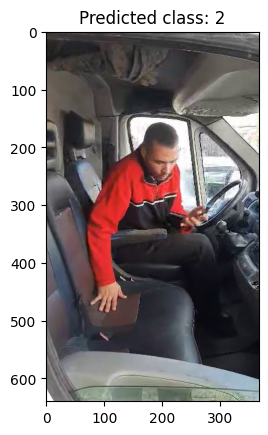

Found 1 validated image filenames.
1/1 [==============================] - 0s 43ms/step


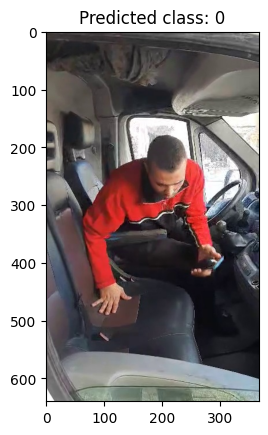

In [8]:
import cv2
import pandas as pd
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import numpy as np
import os

# Load the model
best_model = load_model('best_model.h5')

# Create an ImageDataGenerator object
datagen = ImageDataGenerator()

# Open the video file
cap = cv2.VideoCapture(r"C:\Users\omarm\Downloads\407536961_6277025192397339_9142313526632673030_n.mp4")

# Initialize frame counter
cnt = 0

# Loop until the end of the video
while(cap.isOpened()):
    # Capture frame-by-frame
    ret, frame = cap.read()

    # If the frame was properly read
    if ret == True:
        # Save every 15th frame (for 0.5 second intervals at 30fps video)
        if cnt % 15 == 0:
            # Save the frame as an image
            frame_path = f'frame{cnt}.jpg'
            cv2.imwrite(frame_path, frame)

            # Create a dataframe containing the image file name
            df = pd.DataFrame({'filename': [frame_path]})

            # Use flow_from_dataframe to load and preprocess the image
            img_gen = datagen.flow_from_dataframe(df, 
                                                  directory='.', 
                                                  x_col='filename', 
                                                  class_mode=None, 
                                                  target_size=(640, 480), 
                                                  batch_size=1, 
                                                  shuffle=False)

            # Make a prediction
            predictions = best_model.predict(img_gen)

            # Get the class with the highest probability
            predicted_class = np.argmax(predictions[0])

            # Plot the image with its prediction
            img = plt.imread(frame_path)
            plt.imshow(img)
            plt.title(f'Predicted class: {predicted_class}')
            plt.show()
            os.remove(frame_path)

        # Increment the frame counter
        cnt += 1

    # Break the loop if the video has ended
    else:
        break

# Release the video capture object
cap.release()



0: 640x384 1 person, 1 car, 123.4ms
Speed: 22.0ms preprocess, 123.4ms inference, 21.2ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 330ms/step


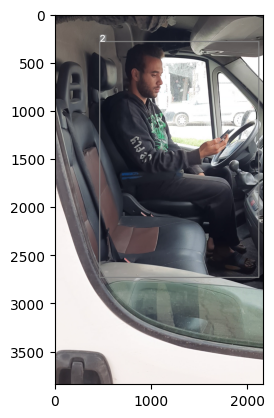


0: 640x384 1 person, 2 cars, 50.1ms
Speed: 7.4ms preprocess, 50.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 66ms/step


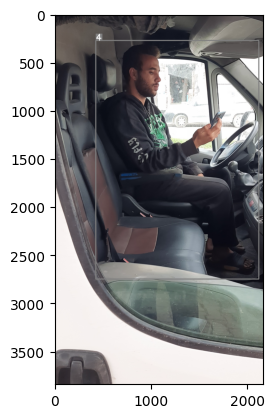


0: 640x384 1 person, 2 cars, 1 cell phone, 57.9ms
Speed: 3.0ms preprocess, 57.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 48ms/step


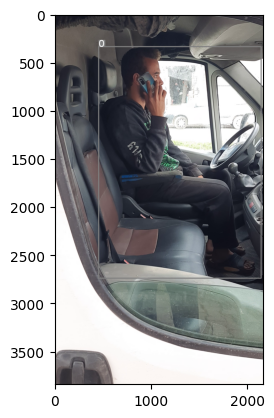


0: 640x384 1 person, 3 cars, 1 suitcase, 1 cell phone, 47.1ms
Speed: 2.0ms preprocess, 47.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 57ms/step


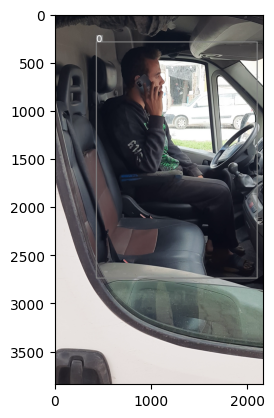


0: 640x384 1 person, 2 cars, 1 suitcase, 1 cell phone, 50.5ms
Speed: 2.0ms preprocess, 50.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


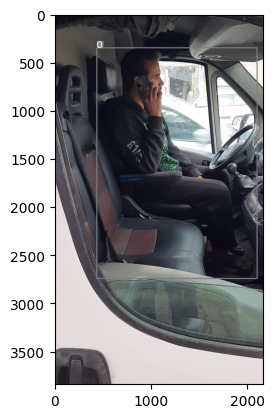


0: 640x384 1 person, 3 cars, 1 suitcase, 52.7ms
Speed: 2.2ms preprocess, 52.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 47ms/step


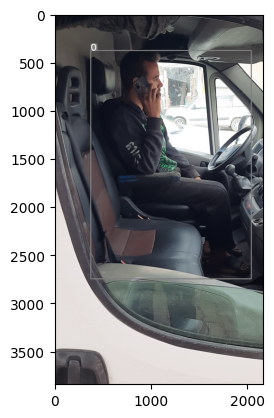


0: 640x384 1 person, 2 cars, 1 truck, 1 suitcase, 1 cell phone, 53.1ms
Speed: 2.0ms preprocess, 53.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 43ms/step


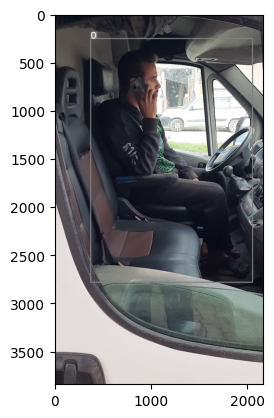


0: 640x384 1 person, 2 cars, 1 truck, 52.1ms
Speed: 2.0ms preprocess, 52.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 59ms/step


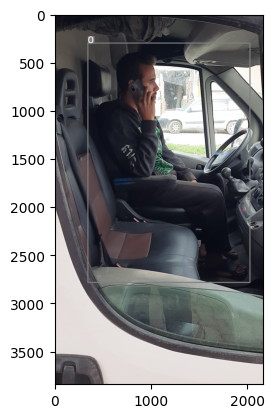


0: 640x384 1 person, 3 cars, 1 suitcase, 53.0ms
Speed: 1.7ms preprocess, 53.0ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 44ms/step


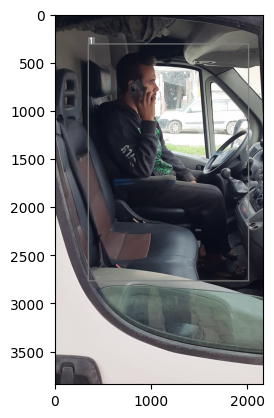


0: 640x384 1 person, 3 cars, 66.4ms
Speed: 2.1ms preprocess, 66.4ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


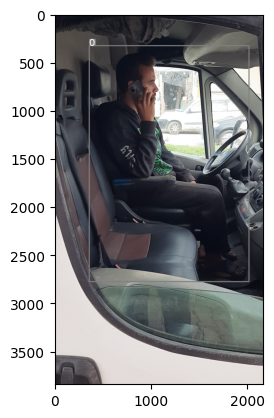


0: 640x384 1 person, 3 cars, 50.1ms
Speed: 1.0ms preprocess, 50.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 45ms/step


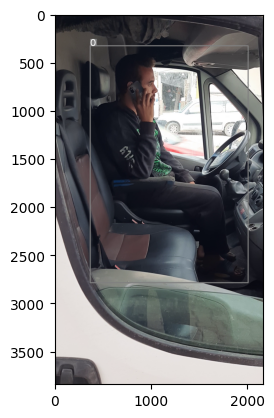


0: 640x384 1 person, 2 cars, 54.1ms
Speed: 2.0ms preprocess, 54.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 45ms/step


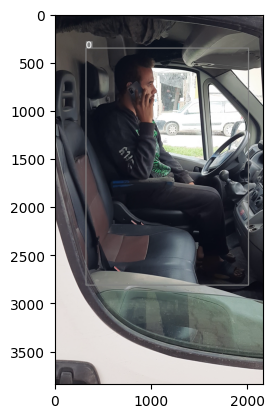


0: 640x384 1 person, 2 cars, 47.5ms
Speed: 2.6ms preprocess, 47.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 47ms/step


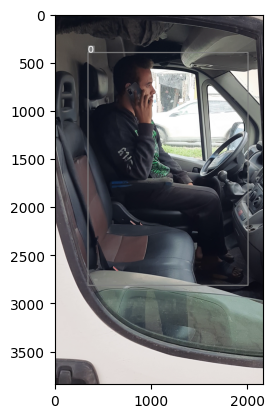


0: 640x384 1 person, 3 cars, 49.6ms
Speed: 2.0ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


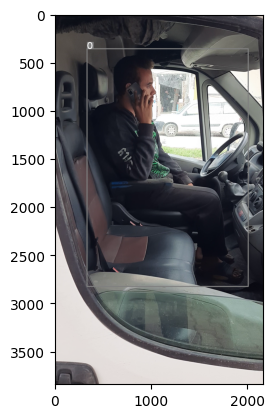


0: 640x384 1 person, 3 cars, 57.7ms
Speed: 3.0ms preprocess, 57.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 45ms/step


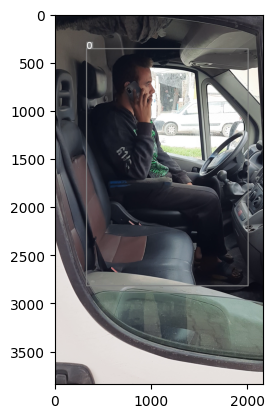


0: 640x384 1 person, 3 cars, 54.6ms
Speed: 3.0ms preprocess, 54.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


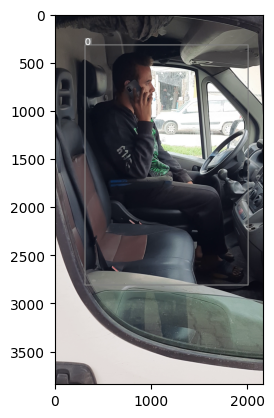


0: 640x384 1 person, 2 cars, 53.5ms
Speed: 2.0ms preprocess, 53.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 50ms/step


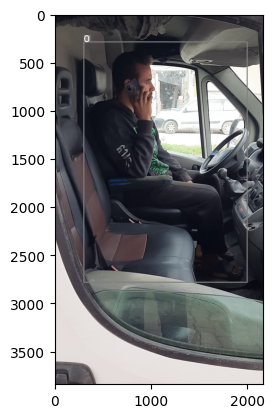


0: 640x384 1 person, 3 cars, 50.6ms
Speed: 2.0ms preprocess, 50.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


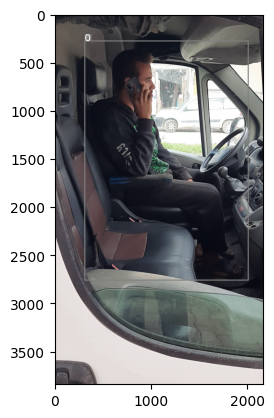


0: 640x384 1 person, 2 cars, 49.7ms
Speed: 2.0ms preprocess, 49.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 47ms/step


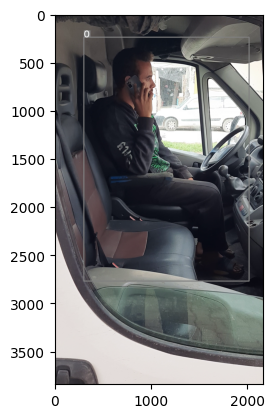


0: 640x384 1 person, 3 cars, 50.9ms
Speed: 3.0ms preprocess, 50.9ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 47ms/step


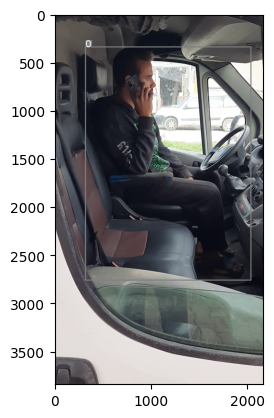


0: 640x384 1 person, 3 cars, 51.4ms
Speed: 2.0ms preprocess, 51.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 43ms/step


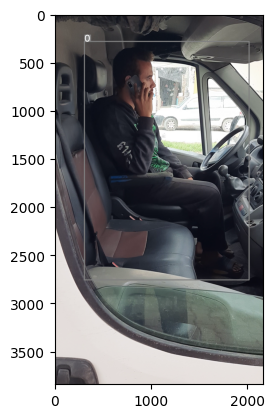


0: 640x384 1 person, 2 cars, 62.2ms
Speed: 3.0ms preprocess, 62.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 46ms/step


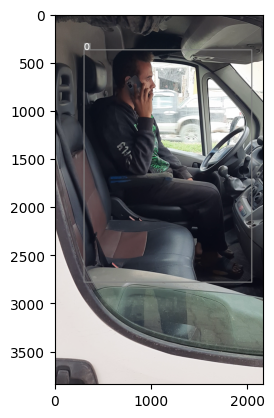


0: 640x384 1 person, 3 cars, 1 cell phone, 50.1ms
Speed: 2.0ms preprocess, 50.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


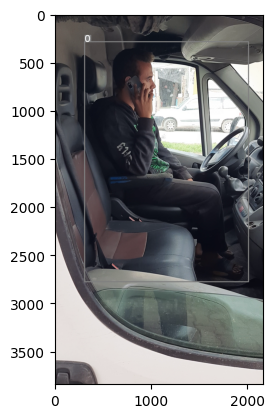


0: 640x384 1 person, 1 car, 52.6ms
Speed: 1.0ms preprocess, 52.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


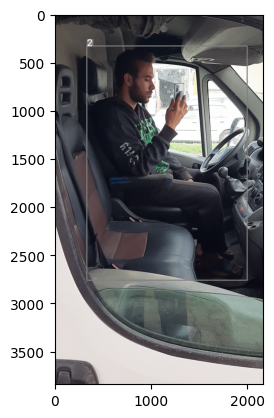


0: 640x384 1 person, 2 cars, 51.7ms
Speed: 2.0ms preprocess, 51.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 45ms/step


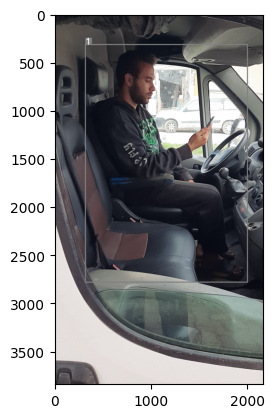


0: 640x384 1 person, 2 cars, 50.1ms
Speed: 2.0ms preprocess, 50.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


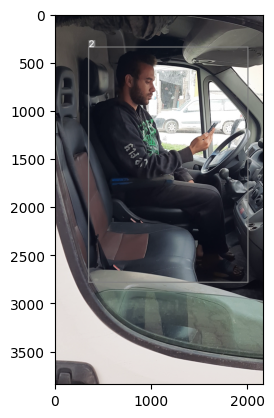


0: 640x384 1 person, 1 car, 48.3ms
Speed: 3.0ms preprocess, 48.3ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


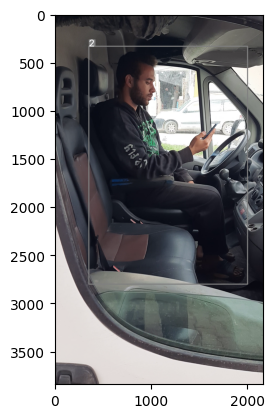


0: 640x384 1 person, 3 cars, 48.2ms
Speed: 1.0ms preprocess, 48.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


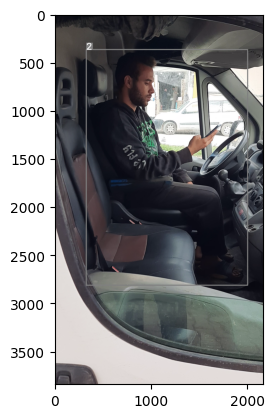


0: 640x384 1 person, 2 cars, 51.8ms
Speed: 5.5ms preprocess, 51.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 44ms/step


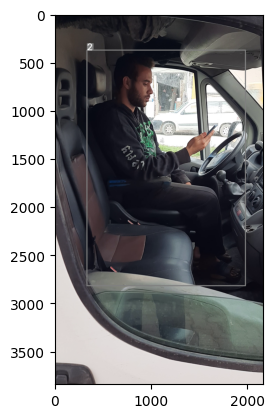


0: 640x384 1 person, 1 car, 49.6ms
Speed: 2.0ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 44ms/step


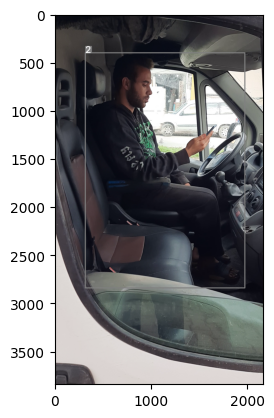


0: 640x384 1 person, 2 cars, 54.7ms
Speed: 3.0ms preprocess, 54.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


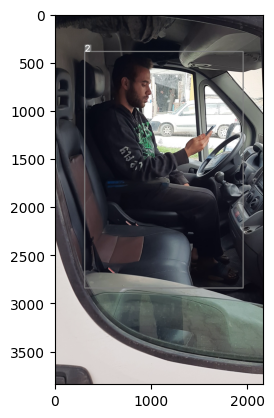


0: 640x384 1 person, 1 car, 51.6ms
Speed: 2.0ms preprocess, 51.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 49ms/step


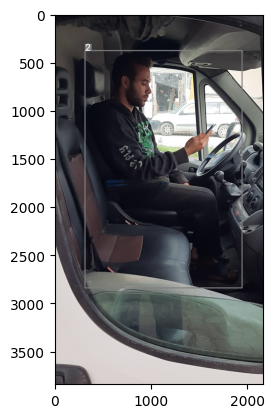


0: 640x384 1 person, 2 cars, 56.1ms
Speed: 2.0ms preprocess, 56.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 43ms/step


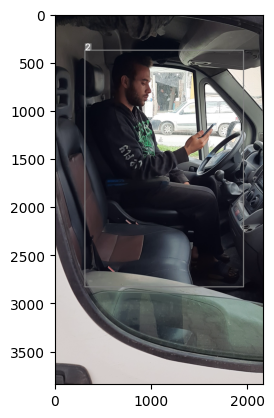


0: 640x384 1 person, 2 cars, 51.6ms
Speed: 2.5ms preprocess, 51.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 35ms/step


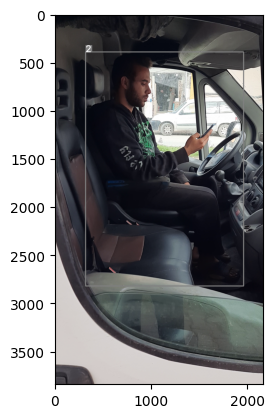


0: 640x384 1 person, 2 cars, 52.2ms
Speed: 2.0ms preprocess, 52.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 45ms/step


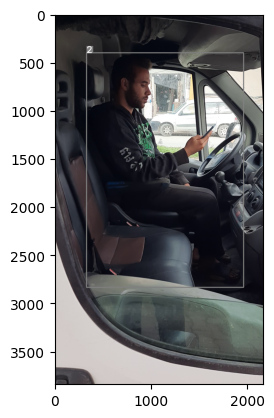


0: 640x384 1 person, 1 car, 1 cell phone, 53.7ms
Speed: 3.0ms preprocess, 53.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


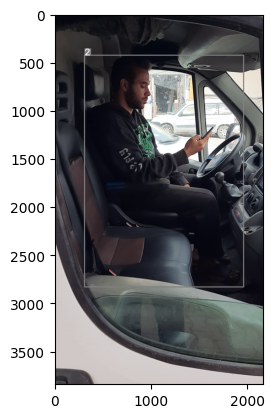


0: 640x384 1 person, 2 cars, 58.2ms
Speed: 2.5ms preprocess, 58.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 44ms/step


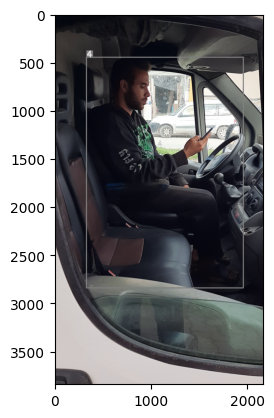


0: 640x384 1 person, 2 cars, 48.6ms
Speed: 5.0ms preprocess, 48.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


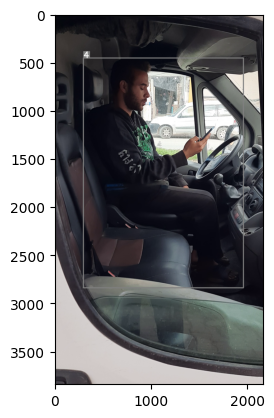


0: 640x384 1 person, 2 cars, 48.6ms
Speed: 3.0ms preprocess, 48.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


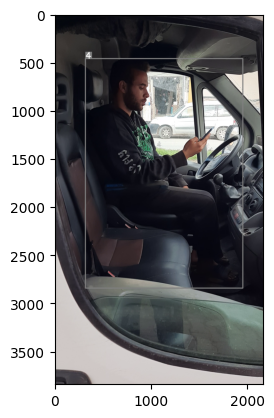


0: 640x384 1 person, 2 cars, 62.7ms
Speed: 2.0ms preprocess, 62.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


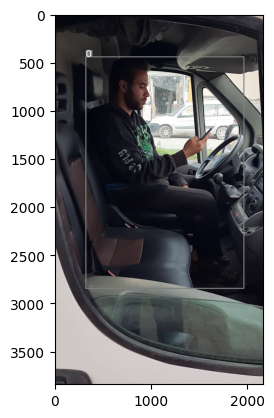


0: 640x384 1 person, 1 car, 1 chair, 1 laptop, 2 cell phones, 53.6ms
Speed: 2.0ms preprocess, 53.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 47ms/step


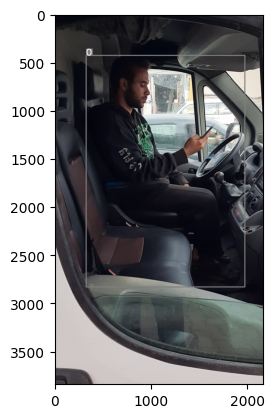


0: 640x384 1 person, 1 chair, 48.7ms
Speed: 3.0ms preprocess, 48.7ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


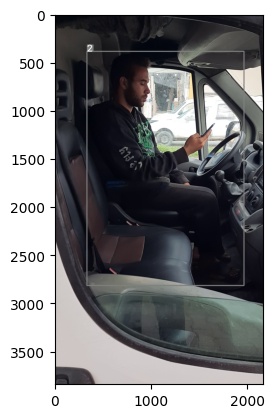


0: 640x384 1 person, 1 car, 1 laptop, 48.7ms
Speed: 3.0ms preprocess, 48.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


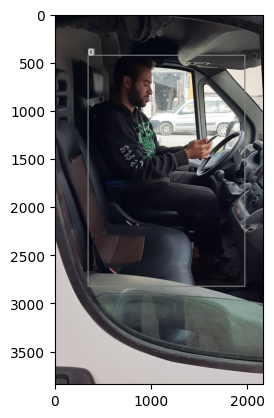


0: 640x384 1 person, 50.6ms
Speed: 2.5ms preprocess, 50.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 53ms/step


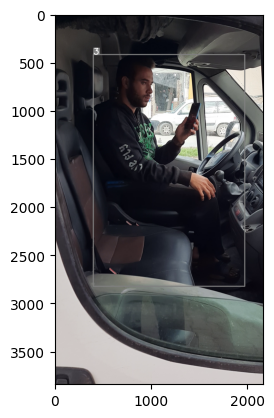


0: 640x384 1 person, 3 cars, 49.6ms
Speed: 4.0ms preprocess, 49.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step


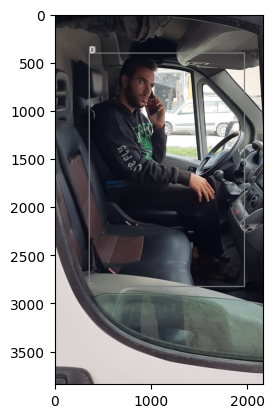


0: 640x384 1 person, 3 cars, 49.1ms
Speed: 1.5ms preprocess, 49.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


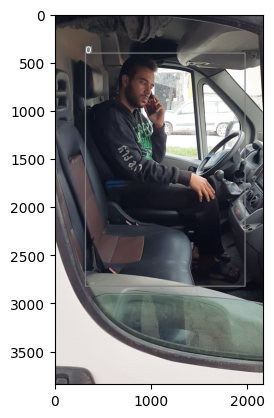


0: 640x384 1 person, 3 cars, 47.6ms
Speed: 4.0ms preprocess, 47.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 46ms/step


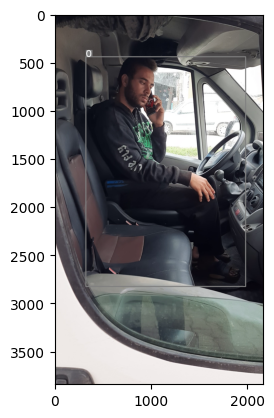


0: 640x384 1 person, 1 car, 51.2ms
Speed: 3.0ms preprocess, 51.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


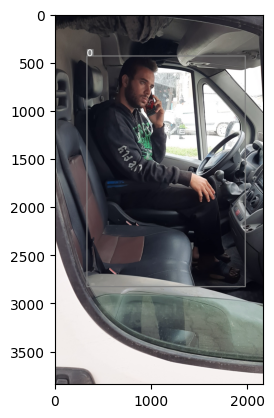


0: 640x384 1 person, 2 cars, 49.1ms
Speed: 2.3ms preprocess, 49.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 38ms/step


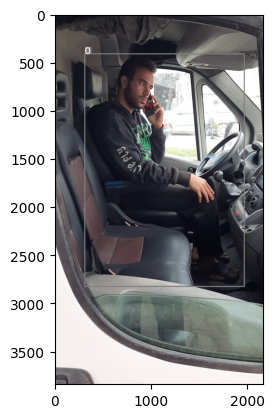


0: 640x384 1 person, 1 car, 57.5ms
Speed: 4.0ms preprocess, 57.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 47ms/step


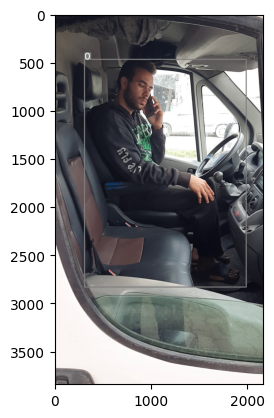


0: 640x384 1 person, 1 car, 50.5ms
Speed: 1.0ms preprocess, 50.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


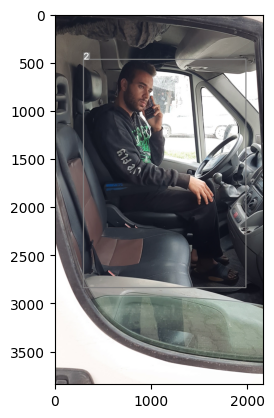


0: 640x384 1 person, 1 car, 50.6ms
Speed: 4.0ms preprocess, 50.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


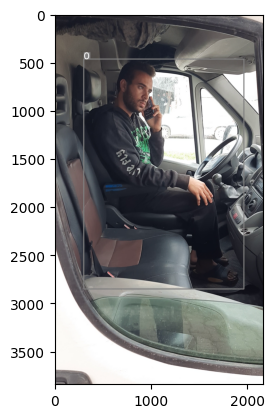


0: 640x384 1 person, 1 car, 49.2ms
Speed: 2.0ms preprocess, 49.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 45ms/step


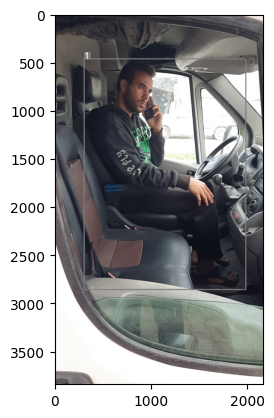


0: 640x384 1 person, 1 car, 49.6ms
Speed: 4.5ms preprocess, 49.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 47ms/step


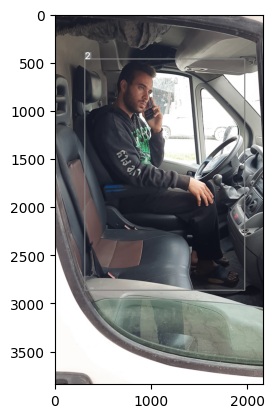


0: 640x384 1 person, 1 car, 50.6ms
Speed: 3.0ms preprocess, 50.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 41ms/step


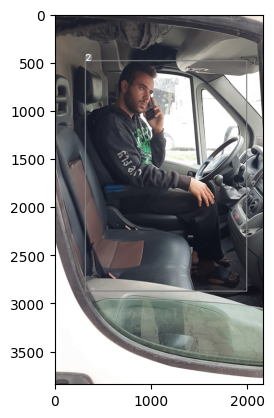


0: 640x384 1 person, 1 car, 50.6ms
Speed: 3.0ms preprocess, 50.6ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 36ms/step


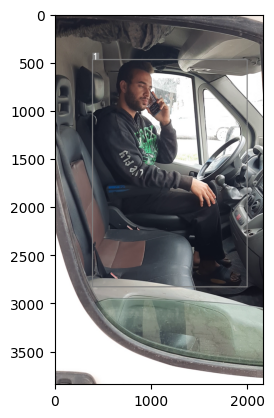


0: 640x384 1 person, 1 car, 50.1ms
Speed: 4.2ms preprocess, 50.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 38ms/step


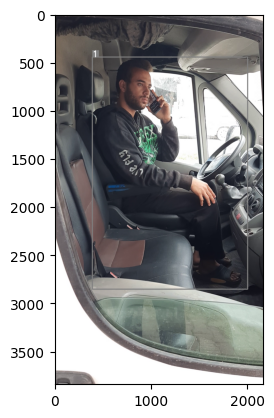


0: 640x384 1 person, 1 car, 52.1ms
Speed: 3.5ms preprocess, 52.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


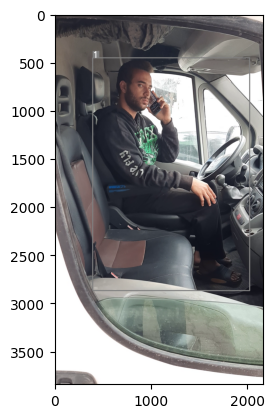


0: 640x384 1 person, 1 car, 52.1ms
Speed: 2.0ms preprocess, 52.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


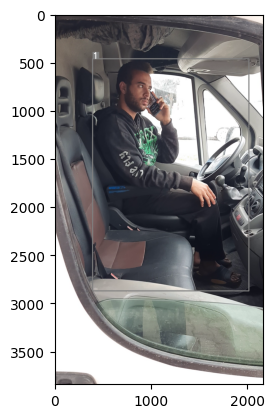


0: 640x384 1 person, 1 car, 47.1ms
Speed: 2.0ms preprocess, 47.1ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step


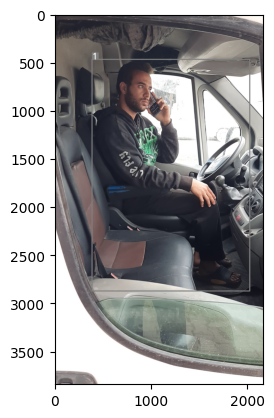


0: 640x384 1 person, 1 car, 51.8ms
Speed: 2.5ms preprocess, 51.8ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 50ms/step


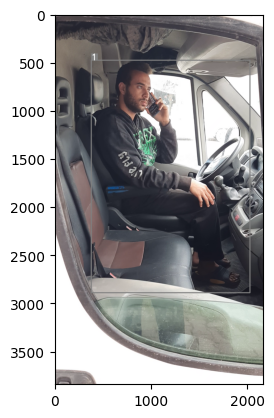


0: 640x384 1 person, 1 car, 65.6ms
Speed: 3.0ms preprocess, 65.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 49ms/step


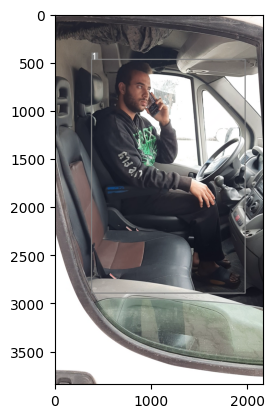


0: 640x384 1 person, 1 car, 55.2ms
Speed: 2.5ms preprocess, 55.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 44ms/step


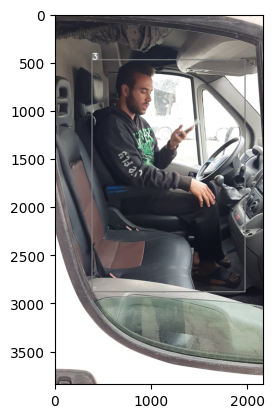


0: 640x384 1 person, 1 car, 51.2ms
Speed: 3.0ms preprocess, 51.2ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


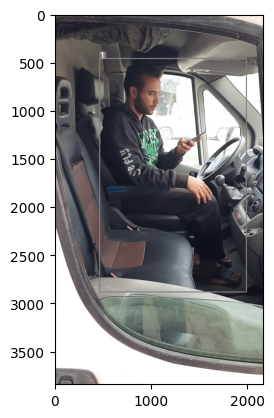


0: 640x384 1 person, 52.1ms
Speed: 3.0ms preprocess, 52.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step


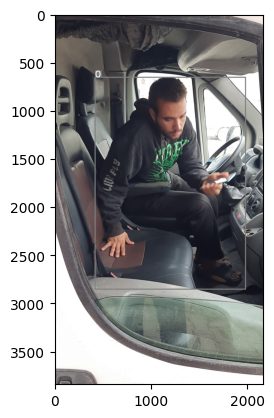


0: 640x384 1 person, 1 car, 52.6ms
Speed: 2.0ms preprocess, 52.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 52ms/step


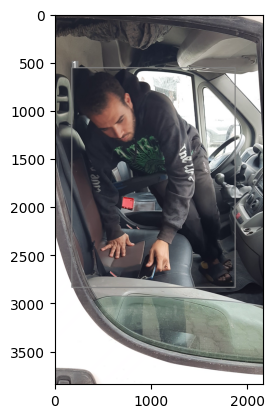

In [9]:
import cv2
import pandas as pd
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import numpy as np
import os
from ultralytics import YOLO
from ultralytics.utils.plotting import Annotator

# Load the YOLO model
yolo = YOLO('yolov8n.pt')

# Load the classification model
classification_model = load_model('best_model(1).h5')

# Create an ImageDataGenerator object
datagen = ImageDataGenerator()

# Open the video file
cap = cv2.VideoCapture(r"C:\Users\omarm\Desktop\tpp\20231203_102328.mp4")

# Initialize frame counter
cnt = 0

# Loop until the end of the video
while(cap.isOpened()):
    # Capture frame-by-frame
    ret, frame = cap.read()

    # If the frame was properly read
    if ret == True:
        # Save every 15th frame (for 0.5 second intervals at 30fps video)
        if cnt % 30 == 0:
            # Predict the objects in the frame using YOLO
            results = yolo.predict(frame)

            # Initialize an Annotator object for the frame
            annotator = Annotator(frame)

            # Loop over each detected object
            for r in results:
                boxes = r.boxes
                for box in boxes:
                    # Check if the object is a person
                    if yolo.names[int(box.cls)] == 'person':
                        # Get the bounding box coordinates
                        b = box.xyxy[0]  # format: (left, top, right, bottom)

                        # Crop the image to get only the bounding box
                        cropped_img = frame[int(b[1]):int(b[3]), int(b[0]):int(b[2])]
                        cropped_img_resized = cv2.resize(cropped_img, (640, 480))

                        # Save the cropped image
                        frame_path = f'frame{cnt}.jpg'
                        cv2.imwrite(frame_path, cropped_img_resized)

                        # Create a dataframe containing the image file name
                        df = pd.DataFrame({'filename': [frame_path]})

                        # Use flow_from_dataframe to load and preprocess the image
                        img_gen = datagen.flow_from_dataframe(df, 
                                                              directory='.', 
                                                              x_col='filename', 
                                                              class_mode=None, 
                                                              target_size=(640, 480), 
                                                              batch_size=1, 
                                                              shuffle=False)

                        # Make a prediction using the classification model
                        predictions = classification_model.predict(img_gen)

                        # Get the class with the highest probability
                        predicted_class = np.argmax(predictions[0])

                        # Annotate the frame with the bounding box and the predicted class
                        annotator.box_label(box.xyxy[0], label=str(predicted_class))

                        # Delete the cropped image file
                        os.remove(frame_path)

            # Display the annotated frame
            plt.imshow(cv2.cvtColor(annotator.im, cv2.COLOR_BGR2RGB))
            plt.show()

        # Increment the frame counter
        cnt += 1

    # Break the loop if the video has ended
    else:
        break

# Release the video capture object
cap.release()


In [55]:
print (predicted_labels)

[[0]
 [1]
 [1]
 ...
 [1]
 [0]
 [0]]


In [1]:
import cv2
import pandas as pd
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
import numpy as np
import os
from ultralytics import YOLO
from ultralytics.utils.plotting import Annotator

# Load the YOLO model
yolo = YOLO('yolov8n.pt')

# Load the classification model
classification_model = load_model('best_model.h5')

# Create an ImageDataGenerator object
datagen = ImageDataGenerator(rescale=1./255)

# Open the video file
cap = cv2.VideoCapture(r"C:\Users\omarm\Downloads\407536961_6277025192397339_9142313526632673030_n.mp4")

# Get the frames per second (fps) of the video
fps = cap.get(cv2.CAP_PROP_FPS)

# Get the codec information of the video
fourcc = cv2.VideoWriter_fourcc(*'XVID')  # Change the codec to 'XVID'

# Create a VideoWriter object to write the annotated frames to a video file
out = cv2.VideoWriter('output.avi', fourcc, fps, (640, 480))  # Change the file extension to .avi

# Initialize frame counter
cnt = 0

# Loop until the end of the video
while(cap.isOpened()):
    # Capture frame-by-frame
    ret, frame = cap.read()

    # If the frame was properly read
    if ret == True:
        # Increment the frame counter
        cnt += 1

        # Save every 15th frame
        if cnt % 15 == 0:
            # Predict the objects in the frame using YOLO
            results = yolo.predict(frame)

            # Initialize an Annotator object for the frame
            annotator = Annotator(frame)

            # Loop over each detected object
            for r in results:
                boxes = r.boxes
                for box in boxes:
                    # Check if the object is a person
                    if yolo.names[int(box.cls)] == 'person':
                        # Get the bounding box coordinates
                        b = box.xyxy[0]  # format: (left, top, right, bottom)

                        # Crop the image to get only the bounding box
                        cropped_img = frame[int(b[1]):int(b[3]), int(b[0]):int(b[2])]
                        cropped_img_resized = cv2.resize(cropped_img, (640, 480))

                        # Save the cropped image
                        frame_path = f'frame{cnt}.jpg'
                        cv2.imwrite(frame_path, cropped_img_resized)

                        # Create a dataframe containing the image file name
                        df = pd.DataFrame({'filename': [frame_path]})

                        # Use flow_from_dataframe to load and preprocess the image
                        img_gen = datagen.flow_from_dataframe(df, 
                                                              directory='.', 
                                                              x_col='filename', 
                                                              class_mode=None, 
                                                              target_size=(640, 480), 
                                                              batch_size=1, 
                                                              shuffle=False)

                        # Make a prediction using the classification model
                        predictions = classification_model.predict(img_gen)

                        # Get the class with the highest probability
                        predicted_class = np.argmax(predictions[0])

                        # Map the predicted class to the corresponding label
                        labels = {0: 'does not have phone', 1: 'hold a phone', 2: 'talk with phone', 3: 'hold a phone', 4: 'talk with phone'}
                        predicted_label = labels[predicted_class]

                        # Annotate the frame with the bounding box and the predicted label
                        annotator.box_label(box.xyxy[0], label=predicted_label)

                        # Delete the cropped image file
                        os.remove(frame_path)

            # Write the annotated frame to the video file 5 times
            for _ in range(5):
                out.write(annotator.im)

# Release the video capture and writer objects
cap.release()
out.release()




0: 640x384 1 person, 1 chair, 120.5ms
Speed: 3.0ms preprocess, 120.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 5s 5s/step

0: 640x384 2 persons, 1 chair, 95.5ms
Speed: 3.0ms preprocess, 95.5ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 44ms/step
Found 1 validated image filenames.
1/1 [==============================] - 0s 37ms/step

0: 640x384 2 persons, 80.6ms
Speed: 3.2ms preprocess, 80.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 40ms/step
Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step

0: 640x384 1 person, 1 chair, 91.5ms
Speed: 3.0ms preprocess, 91.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filename


KeyboardInterrupt



In [2]:


# yaml videooowat
import cv2
import pandas as pd
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
import numpy as np
import os
from ultralytics import YOLO
from ultralytics.utils.plotting import Annotator

# Load the YOLO model
yolo = YOLO('yolov8n.pt')

# Load the classification model
classification_model = load_model('best_model.h5')

# Create an ImageDataGenerator object
datagen = ImageDataGenerator()
       #"C:\Users\omarm\Downloads\ayoub.mp4"
# Open the video file
cap = cv2.VideoCapture(r"C:\Users\omarm\Desktop\tpp\20231203_102328.mp4")

# Initialize frame counter
cnt = 0
person_detected = 0
# Loop until the end of the video
while(cap.isOpened()):
    # Capture frame-by-frame
    ret, frame = cap.read()

    # If the frame was properly read
    if ret == True:
        # Increment the frame counter
        cnt += 1

        # Save every 15th frame
         # Save every 15th frame
        if cnt % 10 == 0:
            # Predict the objects in the frame using YOLO
            results = yolo.predict(frame)

            # Initialize an Annotator object for the frame
            annotator = Annotator(frame)

            # Initialize a variable to store the largest bounding box
            largest_box = None
            largest_area = 0

            # Loop over each detected object
            for r in results:
                boxes = r.boxes
                for box in boxes:
                    # Check if the object is a person
                    if yolo.names[int(box.cls)] == 'person':
                        # Get the bounding box coordinates
                        b = box.xyxy[0]  # format: (left, top, right, bottom)
                        person_detected = 1
                        # Calculate the area of the bounding box
                        area = (b[2] - b[0]) * (b[3] - b[1])

                        # If this bounding box is larger than the current largest bounding box, update the largest bounding box
                        if area > largest_area:
                            largest_box = box
                            largest_area = area
                    else :
                        person_detected = 0
            # If a person was detected, annotate the frame with the largest bounding box and the predicted label
            if largest_box is not None:
                # Get the bounding box coordinates
                b = largest_box.xyxy[0]  # format: (left, top, right, bottom)

                # Crop the image to get only the bounding box
                cropped_img = frame[int(b[1]):int(b[3]), int(b[0]):int(b[2])]
                cropped_img_resized = cv2.resize(cropped_img, (640, 480))

                # Save the cropped image
                frame_path = f'frame{cnt}.jpg'
                cv2.imwrite(frame_path, cropped_img_resized)

                # Create a dataframe containing the image file name
                df = pd.DataFrame({'filename': [frame_path]})

                # Use flow_from_dataframe to load and preprocess the image
                img_gen = datagen.flow_from_dataframe(df, 
                                                      directory='.', 
                                                      x_col='filename', 
                                                      class_mode=None, 
                                                      target_size=(640, 480), 
                                                      batch_size=1, 
                                                      shuffle=False)

                # Make a prediction using the classification model
                predictions = classification_model.predict(img_gen)

                # Get the class with the highest probability
                predicted_class = np.argmax(predictions[0])

                # Map the predicted class to the corresponding label
                labels = {0: 'does not have phone', 1: 'tolk to a phone ', 2: 'hold a phone ', 3: 'tolk to a phone ', 4: 'hold a phone '}
                predicted_label = labels[predicted_class]
           
                # Annotate the frame with the bounding box and the predicted label
                annotator.box_label(largest_box.xyxy[0], label=predicted_label)
                # Delete the cropped image file
                os.remove(frame_path)
                        # Rest of your code...

            # If a person was detected, display the annotated frame
            if person_detected == 1 :
                 cv2.imshow('Video', cv2.resize(annotator.im, (1920, 1080)))
                
            # If no person was detected, display the original frame
            else:
                cv2.imshow('Video', cv2.resize(frame, (1920, 1080)))

            # Break the loop qqqif the 'q' key is pressed
            if cv2.waitKey(1) & 0xFF == ord('q'):
                break

# Release the video caqqqqqqqqqqqqqqqqqqpture object
cap.release()

# Close all OpenCV windows
cv2.destroyAllWindows()
cv2.destroyAllWindows()



0: 640x384 1 person, 1 car, 106.7ms
Speed: 17.2ms preprocess, 106.7ms inference, 21.8ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 314ms/step

0: 640x384 1 person, 2 cars, 72.6ms
Speed: 9.0ms preprocess, 72.6ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 51ms/step

0: 640x384 1 person, 2 cars, 1 cell phone, 62.6ms
Speed: 2.0ms preprocess, 62.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 43ms/step

0: 640x384 1 person, 2 cars, 1 train, 1 cell phone, 78.0ms
Speed: 4.0ms preprocess, 78.0ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 44ms/step

0: 640x384 1 person, 2 cars, 3 cell phones, 52.7ms
Speed: 3.0ms preprocess

In [1]:
import cv2
import pandas as pd
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model
import numpy as np
import os
from ultralytics import YOLO
from ultralytics.utils.plotting import Annotator

# Load the YOLO model
yolo = YOLO('yolov8n.pt')

# Load the classification model
classification_model = load_model('best_modelta7founYaser.h5')

# Create an ImageDataGenerator object
datagen = ImageDataGenerator()

# Open the video file
cap = cv2.VideoCapture(r"C:\Users\omarm\Downloads\407536961_6277025192397339_9142313526632673030_n.mp4")

# Get the frames per second (fps) of the video
fps = cap.get(cv2.CAP_PROP_FPS)

# Get the codec information of the video
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Change the codec to 'mp4v'

# Create a VideoWriter object to write the annotated frames to a video file
out = cv2.VideoWriter('outpute.mp4', fourcc, fps, (640, 480))  # Change the file extension to .mp4

# Initialize frame counter
cnt = 0

# Loop until the end of the video
while(cap.isOpened()):
    # Capture frame-by-frame
    ret, frame = cap.read()

    # If the frame was properly read
    if ret == True:
        # Increment the frame counter
        cnt += 1

        # Save every 15th frame
        if cnt % 15 == 0:
            # Predict the objects in the frame using YOLO
            results = yolo.predict(frame)

            # Initialize an Annotator object for the frame
            annotator = Annotator(frame)

            # Flag to check if a person was detected
            person_detected = False

            # Loop over each detected object
            for r in results:
                boxes = r.boxes
                for box in boxes:
                    # Check if the object is a person
                    if yolo.names[int(box.cls)] == 'person':
                        person_detected = True
                        # Get the bounding box coordinates
                        b = box.xyxy[0]  # format: (left, top, right, bottom)

                        # Crop the image to get only the bounding box
                        cropped_img = frame[int(b[1]):int(b[3]), int(b[0]):int(b[2])]
                        cropped_img_resized = cv2.resize(cropped_img, (640, 480))

                        # Save the cropped image
                        frame_path = f'frame{cnt}.jpg'
                        cv2.imwrite(frame_path, cropped_img_resized)

                        # Create a dataframe containing the image file name
                        df = pd.DataFrame({'filename': [frame_path]})

                        # Use flow_from_dataframe to load and preprocess the image
                        img_gen = datagen.flow_from_dataframe(df, 
                                                              directory='.', 
                                                              x_col='filename', 
                                                              class_mode=None, 
                                                              target_size=(640, 480), 
                                                              batch_size=1, 
                                                              shuffle=False)

                        # Make a prediction using the classification model
                        predictions = classification_model.predict(img_gen)

                        # Get the class with the highest probability
                        predicted_class = np.argmax(predictions[0])

                        # Map the predicted class to the corresponding label
                        labels = {0: 'does not have phone', 1: 'hold a phone', 2: 'talk with phone', 3: 'hold a phone', 4: 'talk with phone'}
                        predicted_label = labels[predicted_class]
               
                        # Annotate the frame with the bounding box and the predicted label
                        annotator.box_label(box.xyxy[0], label=predicted_label)
                        # Delete the cropped image file
                        os.remove(frame_path)
                        # Rest of your code...

            # If a person was detected, write the annotated frame 5 times
            if person_detected:
                for _ in range(5):
                    out.write(cv2.resize(annotator.im, (640, 480)))
                    
            # If no person was detected, write the original frame
            else:
                frame_resized = cv2.resize(frame, (640, 480))  # Resize the frame to match the size of the annotated frames
                out.write(frame_resized)

# Release the video capture and writer objects
cap.release()
out.release()



0: 640x384 1 person, 1 chair, 86.6ms
Speed: 2.0ms preprocess, 86.6ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 6s 6s/step

0: 640x384 2 persons, 1 chair, 162.4ms
Speed: 26.1ms preprocess, 162.4ms inference, 26.5ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 201ms/step
Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step

0: 640x384 2 persons, 55.1ms
Speed: 2.0ms preprocess, 55.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filenames.
1/1 [==============================] - 0s 39ms/step
Found 1 validated image filenames.
1/1 [==============================] - 0s 42ms/step

0: 640x384 1 person, 1 chair, 49.7ms
Speed: 2.0ms preprocess, 49.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 384)
Found 1 validated image filen


KeyboardInterrupt



In [1]:
import cv2

# Open the video file
cap = cv2.VideoCapture(r"C:\Users\omarm\Downloads\407536961_6277025192397339_9142313526632673030_n.mp4")

# Get the frames per second (fps) of the video
fps = cap.get(cv2.CAP_PROP_FPS)

# Get the frame size of the video
frame_size = (int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)), int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)))

# Get the codec information of the video
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Change the codec to 'mp4v'

# Create a VideoWriter object to write the frames to a new video file
out = cv2.VideoWriter('outputte.mp4', fourcc, fps, frame_size)  # Change the file extension to .mp4

# Loop until the end of the video
while(cap.isOpened()):
    # Capture frame-by-frame
    ret, frame = cap.read()

    # If the frame was properly read
    if ret == True:
        # Write the frame to the new video file
        out.write(frame)
    # Break the loop if the video has ended
    else:
        break

# Release the video capture and writer objects
cap.release()
out.release()
print('it s completed ')

it s completed 


In [1]:
import torch
print(torch.__version__)

2.1.1+cpu


In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, BatchNormalization
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import matplotlib.pyplot as plt
from tensorflow.keras import regularizers
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

def build_model():
    model = Sequential()
    model.add(Conv2D(8, (3, 3),1, activation='relu', input_shape=(640, 480, 3)))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(16, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(32, (3, 3), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(64, (5, 5), 1,activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Conv2D(128, (5, 5), 1,padding='same',activation='relu'))
    model.add(MaxPooling2D(pool_size=(2, 2)))
    model.add(Flatten())
    model.add(Dense(units=64, activation='relu'))
    model.add(Dense(2, activation='sigmoid')) 
    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                  loss='binary_crossentropy', 
                  metrics=['accuracy'])
    return model

# Create a data generator
datagen = ImageDataGenerator(
    validation_split=0.25  # set validation split
)

# Load the training data
train_data = datagen.flow_from_directory(directory=r'C:\Users\omarm\Downloads\train',
                                         target_size=(640, 480), 
                                         classes=['trained seatbelt', 'trained no seatbelt'], 
                                         class_mode='binary', 
                                         batch_size=18, 
                                         subset='training')

# Load the validation data
val_data = datagen.flow_from_directory(directory=r'C:\Users\omarm\Downloads\train',
                                       target_size=(640, 480), 
                                       classes=['trained seatbelt', 'trained no seatbelt'], 
                                       class_mode='binary', 
                                       batch_size=18, 
                                       subset='validation')

model = build_model()

history = model.fit(train_data,
             epochs=15,
             validation_data=val_data,
             )

# Plot accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

model.save('classification_a_3.h5')
